In [1]:
#Import the relevant models:
import awkward as ak
import os
import numpy as np
import uproot
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from hffrag import fixedbinning
from hffrag import binneddensity
from numpy.lib.recfunctions import structured_to_unstructured
import tensorflow as tf
import tensorflow_addons as tfa
from sklearn.ensemble import RandomForestRegressor
import DeepSetNeuralNetArchitecture as DSNNA
from HffragDeepSetsProjectionMultivariate import DeepSetsProjection
from xgboost import XGBRegressor
from sklearn.preprocessing import StandardScaler

2023-02-23 08:08:27.666125: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-02-23 08:08:27.816839: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-02-23 08:08:27.821657: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-02-23 08:08:27.821679: I tensorflow/compiler/xla/stream_executor/cuda/cudart_stub.cc:29] Ignore 

number of jets to train on:
141329


/home/physics/phujdj/DeepLearningParticlePhysics/hffrag.py:136: RuntimeWarning: overflow encountered in sinh
  pzs = numpy.where(mask, pts, pts * numpy.sinh(etas))
/home/physics/phujdj/anaconda3/envs/SpocFit/lib/python3.9/site-packages/tensorflow_addons/utils/ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.8.0 and strictly below 2.11.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.11.0 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addons's version. 
You can find the compatibility matrix in TensorFlow Addon's readme:
https://github.com/tensorflow/addons
  warnings.warn(


In [2]:
%matplotlib inline
plt.rcParams['axes.facecolor'] = 'white'
plt.rcParams['savefig.facecolor'] = 'red'
plt.rc('text',usetex = False)
plt.rc('font',family = 'Times New Roman')
%config InlineBackend.print_figure_kwargs={'facecolor' : "w"}

In [3]:
# The data is being stored in a tree datastructure.
# We access the charm root using this command
tree = uproot.open("/storage/epp2/phswmv/data/hffrag/hffrag.root:CharmAnalysis")

In [4]:
# Initial parameters
MASKVAL = -999 # This value is introduced to ensure arrays are regular (Of the same size). They will be masked later by the network
MAXTRACKS = 32 # This value is the maximum number of tracks allowed per event
BATCHSIZE = 64 # This is the batch size of the mini batches used during training
EPOCHS = 1000  # This is the default number of epochs for which the neural network will train providing that early stopping does not occur
MAXEVENTS = 2e5 #This is the maximum number of events that will the program will accept
LR = 1e-4 #This is the default learning rate

In [5]:
# Select the features we wish to study
track_features = ["AnalysisTracks_pt", "AnalysisTracks_eta", "AnalysisTracks_phi", "AnalysisTracks_z0sinTheta",
                  "AnalysisTracks_d0sig", "AnalysisTracks_d0", "AnalysisTracks_d0sigPV", "AnalysisTracks_d0PV"]
jet_features = ["AnalysisAntiKt4TruthJets_pt", "AnalysisAntiKt4TruthJets_eta", "AnalysisAntiKt4TruthJets_phi", "AnalysisAntiKt4TruthJets_m","AnalysisAntiKt4TruthJets_ghostB_pdgId",
                "AnalysisAntiKt4TruthJets_ghostB_pt", "AnalysisAntiKt4TruthJets_ghostB_eta","AnalysisAntiKt4TruthJets_ghostB_phi", "AnalysisAntiKt4TruthJets_ghostB_m"]
SV_features = ["TruthParticles_Selected_LxyT"]

In [6]:
# Read in the data from the root file
features = tree.arrays(jet_features+track_features + SV_features, entry_stop=MAXEVENTS)

In [7]:
#Select the events of interest
events = features[ak.sum(features["AnalysisAntiKt4TruthJets_pt"] > 25000, axis = 1) > 0]

In [8]:
# Displays the number of jets being trained on
jets = events[jet_features][:,0]
print("The number of jets to train on is: ", len(jets))
print("The number of track features is: ",len(track_features))

# Select tracks from the events
tracks = events[track_features]
Secondary_Displacement_temp_first = events[SV_features]

# Match the tracks to the jets
mask = DSNNA.Match_Tracks(jets, tracks)
matchedtracks = tracks[mask]

# Pad and Flatten the data
matchedtracks = DSNNA.flatten(matchedtracks, MAXTRACKS)

bjets = ak.sum(jets["AnalysisAntiKt4TruthJets_ghostB_pt"] > 5000, axis=1) > 0
Secondary_Displacement_temp_a = DSNNA.flatten(Secondary_Displacement_temp_first, 6).to_numpy()
Secondary_Displacement_temp_b = Secondary_Displacement_temp_a[:,0]
Secondary_Displacement_temp = Secondary_Displacement_temp_b[bjets]
jets = jets[bjets]

# Obtain the pt, eta and phi of each b hadron jet
bhads_pt = jets["AnalysisAntiKt4TruthJets_ghostB_pt"][:, 0].to_numpy()
bhads_eta = jets["AnalysisAntiKt4TruthJets_ghostB_eta"][:,0].to_numpy()
bhads_phi = jets["AnalysisAntiKt4TruthJets_ghostB_phi"][:,0].to_numpy()
bhads_m = jets["AnalysisAntiKt4TruthJets_ghostB_m"][:,0].to_numpy()
bhads_PGID = jets["AnalysisAntiKt4TruthJets_ghostB_pdgId"][:,0].to_numpy()

jets_pt = jets["AnalysisAntiKt4TruthJets_pt"].to_numpy()
jets_eta = jets["AnalysisAntiKt4TruthJets_eta"].to_numpy()
jets_phi = jets["AnalysisAntiKt4TruthJets_phi"].to_numpy()
jets_m = jets["AnalysisAntiKt4TruthJets_m"].to_numpy()
b_jets = np.stack([jets_pt,jets_eta,jets_phi, jets_m], axis = -1)

bhads = np.stack([bhads_pt,bhads_eta,bhads_phi, bhads_m],axis = -1) #Combine the momentum, eta and phi for each jet into one array

print("There are {} outputs".format(np.shape(bhads)[1])) # Display the number of target features the neural network will predict
matchedtracks = matchedtracks[bjets]
print("There are {} inputs".format(np.shape(matchedtracks)[1])) # Display the number of target features the neural network will use in it's predictions

The number of jets to train on is:  199840
The number of track features is:  8
There are 4 outputs
There are 32 inputs


In [9]:
Secondary_Displacement = np.array([x[0] for x in Secondary_Displacement_temp])
print(np.min(Secondary_Displacement), np.max(Secondary_Displacement))

-999.0 115.98360443115234


In [10]:
# Transform the jet and tracks to unstructed data.
jets = structured_to_unstructured(jets[jet_features[:-5]])
matchedtracks = structured_to_unstructured(matchedtracks)

In [11]:
# Convert the coordinates of the b jets and tracks to cartesian coordinates
polartracks = matchedtracks.to_numpy()
Num_events = MAXTRACKS
tracks_pt = polartracks[:,:,0].reshape(-1,Num_events,1)
tracks_eta = polartracks[:,:,1].reshape(-1,Num_events,1)
tracks_phi = polartracks[:,:,2].reshape(-1,Num_events,1)

tracks_pep = np.concatenate([tracks_pt,tracks_eta,tracks_phi], axis = -1) 
print(tracks_pep.shape)

jets_pt = b_jets[:,0].reshape(-1,1)
jets_eta = b_jets[:,1].reshape(-1,1)
jets_phi = b_jets[:,2].reshape(-1,1)

b_jets_pep = np.concatenate([jets_pt,jets_eta,jets_phi], axis = -1) 
print(b_jets_pep.shape)

tracks_p = DSNNA.pt_eta_phi_2_px_py_pz_tracks(matchedtracks.to_numpy())
bhads = DSNNA.pt_eta_phi_2_px_py_pz_jets(bhads)
b_jets_p = DSNNA.pt_eta_phi_2_px_py_pz_jets(b_jets)
b_jets_m = b_jets[:,-1].reshape(-1,1)

#Combine the momenta of the tracks with the rest of the track features to form the track dataset
tracks = np.concatenate([tracks_p,tracks_pep,matchedtracks[:,:,3:].to_numpy()],axis = 2)
b_jets = np.concatenate([b_jets_p,b_jets_pep,b_jets_m] ,axis = 1)

(96659, 32, 3)
(96659, 3)


/home/physics/phujdj/DeepLearningParticlePhysics/DeepSetNeuralNetArchitecture.py:146: RuntimeWarning: overflow encountered in sinh
  pzs = np.where(mask1 | mask3, pts, pts * np.sinh(etas))


In [12]:
tracks = np.ma.masked_values(tracks,-999)
bhads_fractions_px = bhads[:,0]/b_jets[:,0]
bhads_fractions_py = bhads[:,1]/b_jets[:,1]
bhads_fractions_pz = bhads[:,2]/b_jets[:,2]
bhads_fractions_pt = bhads_pt/b_jets_pep[:,0]
print(bhads_fractions_px.shape)

(96659,)


In [13]:
b_jets_mag = np.linalg.norm(b_jets[:,:3], axis = 1)
bhads_fractions = np.stack([bhads_fractions_px,bhads_fractions_py, bhads_fractions_pz], axis = -1)
bhads_projection = ((bhads[:,:3]*b_jets[:,:3]).sum(axis = 1))/(b_jets_mag**2)
print(bhads_fractions.shape)

Tracks_Momentum = np.sqrt(tracks[:, : ,0]**2 + tracks[:,:,1]**2 + tracks[:,:,2]**2)
Tracks_4_Momentum = np.stack([Tracks_Momentum, tracks[:,:,0], tracks[:,:,1], tracks[:,:,2]], axis = -1)
print(Tracks_4_Momentum.shape)

Tracks_Invariant_Mass = np.sqrt((np.sum(Tracks_4_Momentum, axis = 1) * np.sum(Tracks_4_Momentum, axis = 1)).sum(axis = -1))
print(Tracks_Invariant_Mass.shape)

(96659, 3)


/tmp/ipykernel_7640/2222755888.py:6: RuntimeWarning: invalid value encountered in sqrt
  Tracks_Momentum = np.sqrt(tracks[:, : ,0]**2 + tracks[:,:,1]**2 + tracks[:,:,2]**2)


(96659, 32, 4)
(96659,)


In [13]:
#Identify the outliers in the dataset and remove them to prevent spikes during learning.
print(np.max(bhads_fractions_px), np.min(bhads_fractions_px))
print(np.max(bhads_fractions_py), np.min(bhads_fractions_py))
print(np.max(bhads_fractions_pz), np.min(bhads_fractions_pz))
print(np.min(bhads_fractions_pt), np.min(bhads_fractions_pt))
array = [x for x in range(bhads_fractions_px.shape[0])]

#Remove the outliers in the dataset with momenta fractions and projections that are either unphysical or statistically unlikely
bhads_trial = np.stack([array,bhads_fractions_px, bhads_fractions_py, bhads_fractions_pz, bhads_projection, Secondary_Displacement], axis = -1)
bhads_fractions_clean  = bhads_trial[(bhads_trial[:,1] <= 10) & (bhads_trial[:,1] >= -10) & (bhads_trial[:,2] <= 10) & (bhads_trial[:,2] >= -10) & (bhads_trial[:,3] <= 10) & (bhads_trial[:,3] >= -10) & (bhads_trial[:,4] >= -10) & (bhads_trial[:,4] <= 10) & (bhads_trial[:,5] >= -10) * (bhads_trial[:,5] <= 10)]
print(bhads_fractions_clean.shape)

#Compare to the original range of the momenta fractions
print(np.max(bhads_fractions_clean[:,1]), np.min(bhads_fractions_clean[:,1]))
indices = bhads_fractions_clean[:,0]
print(indices.shape)

618.1237235802715 -4195.466731248074
81.60295597226761 -34465.39587820514
286.70118793549557 -709.6182655719883
0.008578880941776086 0.008578880941776086


NameError: name 'Secondary_Displacement' is not defined

In [14]:
b_jets_mag = np.linalg.norm(b_jets[:,:3], axis = 1)
bhads_mag = np.linalg.norm(bhads[:,:3], axis = 1)
tracks_Momentum = np.sum(np.linalg.norm(tracks[:,:,:3], axis = 2))

bhads_fractions_px = bhads[:,0]/b_jets[:,0]
bhads_fractions_py = bhads[:,1]/b_jets[:,1]
bhads_fractions_pz = bhads[:,2]/b_jets[:,2]
print(bhads_fractions_px.shape)

b_jets_energy = np.sqrt((b_jets_m[:,0]**2) + (b_jets_mag**2))
print(b_jets_energy.shape, b_jets_m.shape)

b_jets_energy_pt = np.sqrt((b_jets_m[:,0]**2) + (b_jets[:,4]**2))
b_jets_energy_pt.shape

b_jet_energy_mass_ratio = b_jets_energy/b_jets_m[:,0]

print(b_jet_energy_mass_ratio.shape)
bhads_energy = np.sqrt((bhads_m**2) + (bhads_mag**2))
bhads_energy.shape

bhads_energy_mass_ratio = bhads_energy/bhads_m

print(bhads_fractions[0])
print(bhads[0,0]/b_jets[0,0])
print(np.min(bhads_fractions),np.max(bhads_fractions))

print(bhads_fractions_px[0])
print(bhads[0,0]/b_jets[0,0])
print(np.min(bhads_fractions_px),np.max(bhads_fractions_px))

print("Hello")
sum_px_tracks = np.sum(tracks[:,:,0], axis = 1)
sum_py_tracks = np.sum(tracks[:,:,1], axis = 1)
sum_pz_tracks = np.sum(tracks[:,:,2], axis = 1)
sum_pt_tracks = np.sum(tracks[:,:,3], axis = 1)
print(sum_pt_tracks.shape)

sum_px_tracks_RSE = np.sqrt(np.sum(tracks[:,:,0]**2, axis = 1))
sum_py_tracks_RSE= np.sqrt(np.sum(tracks[:,:,1]**2, axis = 1))
sum_pz_tracks_RSE = np.sqrt(np.sum(tracks[:,:,2]**2, axis = 1))
sum_pt_tracks_RSE = np.sqrt(np.sum(tracks[:,:,3]**2, axis = 1))
print(sum_pt_tracks_RSE.shape)

RSM_scaled_px = sum_px_tracks_RSE/sum_px_tracks
RSM_scaled_py = sum_py_tracks_RSE/sum_py_tracks
RSM_scaled_pz = sum_pz_tracks_RSE/sum_pz_tracks
RSM_scaled_pt = sum_pt_tracks_RSE/sum_pt_tracks
print(RSM_scaled_pt.shape)

RMS_scaled_px = np.sqrt(np.sum(tracks[:,:,0]**2, axis = 1)/MAXTRACKS)
RMS_scaled_py = np.sqrt(np.sum(tracks[:,:,1]**2, axis = 1)/MAXTRACKS)
RMS_scaled_pz = np.sqrt(np.sum(tracks[:,:,2]**2, axis = 1)/MAXTRACKS)
RMS_scaled_pt = np.sqrt(np.sum(tracks[:,:,3]**2, axis = 1)/MAXTRACKS)
print(RMS_scaled_pt.shape)

Log_px_tracks = np.log(abs(tracks[:,:,0]/b_jets[:,np.newaxis,0]))
Log_py_tracks = np.log(abs(tracks[:,:,1]/b_jets[:,np.newaxis,1]))
Log_pz_tracks = np.log(abs(tracks[:,:,2]/b_jets[:,np.newaxis,2]))
Log_pt_tracks = np.log(abs(tracks[:,:,3]/b_jets[:,np.newaxis,3]))
Log_tracks = np.stack([Log_px_tracks, Log_py_tracks, Log_pz_tracks, Log_pt_tracks], axis = -1)

Log_Sum_px = np.log(sum_px_tracks/b_jets[:,0])
Log_Sum_py = np.log(sum_py_tracks/b_jets[:,1])
Log_Sum_pz = np.log(sum_pz_tracks/b_jets[:,2])
Log_Sum_pt = np.log(sum_pt_tracks/b_jets[:,3])
Log_Momenta = np.log(abs(tracks_Momentum/np.sum(b_jets[:,:3], axis = 1)))
print(Log_Sum_pt.shape)

tracks_fractions_px = tracks[:,:,0]/b_jets[:,np.newaxis,0]
tracks_fractions_py = tracks[:,:,1]/b_jets[:,np.newaxis,1]
tracks_fractions_pz = tracks[:,:,2]/b_jets[:,np.newaxis,2]
tracks_fractions_pt = tracks[:,:,3]/b_jets[:,np.newaxis,3]
print(tracks_fractions_pt.shape)
Track_fractions = np.stack([tracks_fractions_px,tracks_fractions_py, tracks_fractions_pz], axis = -1)
print(Track_fractions.shape)

print(Track_fractions.shape)
print(tracks[0,0,0]/b_jets[0,0])
print(np.mean(Track_fractions),np.std(Track_fractions))

print("hey")
Tracks_projection = ((tracks[:,:,:3]*b_jets[:,np.newaxis,:3]).sum(axis = 2)/(b_jets_mag[:,np.newaxis]**2))
print(Tracks_projection.shape)
Track_Momenta = np.stack([sum_px_tracks, sum_py_tracks, sum_pz_tracks], axis = -1)
print(Track_Momenta.shape)
Sum_Tracks_projection = ((Track_Momenta*b_jets[:,:3]).sum(axis = 1))/(b_jets_mag**2)
print(Sum_Tracks_projection.shape)

b_jet_energy_ratio_px = sum_px_tracks/b_jets_energy
b_jet_energy_ratio_py = sum_py_tracks/b_jets_energy
b_jet_energy_ratio_pz = sum_pz_tracks/b_jets_energy
b_jet_energy_ratio_pt = sum_pt_tracks/b_jets_energy
print(b_jet_energy_ratio_pt.shape)

b_jet_energy_ratio_cart = b_jets_mag/b_jets_energy
b_jet_energy_ratio_pt = b_jets[:,4]/b_jets_energy
print(b_jet_energy_ratio_pt.shape)

b_jet_energy_ratio_total = np.sum(b_jets[:,4])/np.sum(b_jets_energy)  
b_jet_transverse_mass = np.sqrt(b_jets_energy**2 - b_jets[:,2]**2)
bhads_transverse_mass = np.sqrt(bhads_energy**2 - bhads[:,2]**2)
print(b_jet_transverse_mass[0])
print(b_jet_energy_ratio_total.shape)
print(b_jet_transverse_mass.shape)
print(np.full((len(b_jets)),b_jet_energy_ratio_total).shape)
print("end")
bhads_projection = ((bhads[:,:3]*b_jets[:,:3]).sum(axis = 1))/(b_jets_mag**2)

print(np.mean(b_jets_energy),np.std(b_jets_energy))


b_jets = np.stack([b_jets[:,0], b_jets[:,1], b_jets[:,2],b_jets[:,3],b_jets[:,4], b_jets[:,5], b_jets[:,6], b_jets_mag, sum_px_tracks, sum_py_tracks, sum_pz_tracks, sum_pt_tracks, sum_px_tracks_RSE, sum_py_tracks_RSE, sum_pz_tracks_RSE, sum_pt_tracks_RSE, RSM_scaled_px, RSM_scaled_py, RSM_scaled_pz, RSM_scaled_pt, RMS_scaled_px, RMS_scaled_py, RMS_scaled_pz, RMS_scaled_pt, b_jet_transverse_mass, Log_Sum_px, Log_Sum_py, Log_Sum_pz, Log_Sum_pt, Log_Momenta, b_jets_energy, b_jet_energy_ratio_px, b_jet_energy_ratio_py, b_jet_energy_ratio_pz, b_jet_energy_ratio_cart, b_jet_energy_ratio_pt, b_jet_energy_mass_ratio, np.full((len(b_jets),),b_jet_energy_ratio_total)], axis = -1)
bhads_targets = np.stack([bhads[:,0],bhads[:,1], bhads[:,2], bhads_pt, bhads_eta, bhads_phi, bhads_fractions_px, bhads_fractions_py, bhads_fractions_pz, bhads_energy, bhads_transverse_mass, bhads_energy_mass_ratio, bhads_projection], axis = -1)

(96659,)
(96659,) (96659, 1)
(96659,)
[0.9923946  1.00824593 0.99120818]
0.9923945992521676
-34465.39587820514 618.1237235802715
0.9923945992521676
0.9923945992521676
-4195.466731248074 618.1237235802715
Hello
(96659,)


/tmp/ipykernel_7640/100173683.py:16: RuntimeWarning: divide by zero encountered in true_divide
  b_jet_energy_mass_ratio = b_jets_energy/b_jets_m[:,0]


(96659,)
(96659,)
(96659,)


/tmp/ipykernel_7640/100173683.py:63: RuntimeWarning: divide by zero encountered in log
  Log_Sum_px = np.log(sum_px_tracks/b_jets[:,0])
/tmp/ipykernel_7640/100173683.py:63: RuntimeWarning: invalid value encountered in log
  Log_Sum_px = np.log(sum_px_tracks/b_jets[:,0])
/tmp/ipykernel_7640/100173683.py:64: RuntimeWarning: divide by zero encountered in log
  Log_Sum_py = np.log(sum_py_tracks/b_jets[:,1])
/tmp/ipykernel_7640/100173683.py:64: RuntimeWarning: invalid value encountered in log
  Log_Sum_py = np.log(sum_py_tracks/b_jets[:,1])
/tmp/ipykernel_7640/100173683.py:65: RuntimeWarning: divide by zero encountered in log
  Log_Sum_pz = np.log(sum_pz_tracks/b_jets[:,2])
/tmp/ipykernel_7640/100173683.py:65: RuntimeWarning: invalid value encountered in log
  Log_Sum_pz = np.log(sum_pz_tracks/b_jets[:,2])
/tmp/ipykernel_7640/100173683.py:66: RuntimeWarning: divide by zero encountered in log
  Log_Sum_pt = np.log(sum_pt_tracks/b_jets[:,3])


(96659,)
(96659, 32)
(96659, 32, 3)
(96659, 32, 3)
0.14894195156291137
-670.9594413217917 469.1820966775337
hey
(96659, 32)
(96659, 3)
(96659,)
(96659,)
(96659,)
79564.74
()
(96659,)
(96659,)
end
215380.48 189104.06


In [15]:
"""
0 - Momentum Px Scaled
1 - Momentum Py Scaled
2 - Momentum Pz Scaled
3-  Momentum Pt Scaled
4-  Momentum Eta Scaled
5 - Momentum Phi Scaled
6 - Tranvserse Impact parameter sin component
7 - Longitudinal Impact parameter
8 - Longitudinal Impact parameter signficiance
9 - Longitudinal Impact Parameter w.r.t PV
10 - Longitudinal Impact Parameter wr.r.t PV
11 - Momentum Fraction Px Scaled
12 - Momentum Fraction Py Scaled
13 - Momentum Fraction Pz Scaled
14 - Momentum Fraction pt Scaled.
15 - Logarithm of px of the tracks / b_jet x momenta
16 - Logarithm of py of the tracks / b_jet y momenta
17 - Logarithm of pz of the tracks / b_jet z momenta
18 - Logarithm of sum pt of the tracks / b_jet t momenta
"""
Tracks_input = np.concatenate([tracks, Track_fractions, Log_tracks], axis = -1)
print(Tracks_input.shape)

(96659, 32, 18)


In [16]:
"""
0 - Momentum Px Scaled
1 - Momentum Py Scaled
2 - Momentum Pz Scaled
3 - Momentum Pt Scaled
4 - Momentum eta Scaled
5 - Momentum Phi Scaled
6 - Sum px of the tracks
7 - Sum py of the tracks
8 - Sum pz of the tracks
9 - Sum pt of the tracks
10 - Sqrt of the Sum px of the tracks
11 - Sqrt of the Sum py of the tracks
12 - Sqrt of the Sum pz of the tracks
13 - Sqrt of the Sum pt of the tracks
14 - Sqrt of the Sum px of the tracks scaled by the sum px of the tracks
15 - Sqrt of the Sum py of the tracks scaled by the sum py of the tracks
16 - Sqrt of the Sum pz of the tracks scaled by the sum pz of the tracks
17 - Sqrt of the Sum pt of the tracks scaked by the sum pt of the tracks
18 - Root Mean Square of the px momenta of the tracks
19 - Root Mean Square of the py momenta of the tracks
20 - Root Mean Square of the pz momenta of the tracks
21 - Root Mean Square of the pt momenta of the tracks
22 - Tranvserse mass of the b-jets
23 - Logarithm of the  Sum px of the tracks divide by the b_jet x momenta
24 - Logarithm of the  Sum py of the tracks divide by the b_jet y momenta
25 - Logarithm of the  Sum pz of the tracks divide by the b_jet z momenta
26 - Logarithm of the total momenta of the tracks divided by the b_jet total momenta
27 - B_jet energy
28 - B_jet energy ratio px
29 - B_jet energy ratio py
30 - B_jet energy ratio pz
31 - B_jet energy ratio pt
32 - B_jet energy ratio cart
32 - B_jet energy ratio pt
33 - B_jet energy ratio total
"""
b_jets_input = np.concatenate([b_jets, Tracks_projection, Sum_Tracks_projection.reshape(-1,1)], axis = -1)
print(b_jets_input.shape)

(96659, 71)


In [17]:
#Masking out the padding added to some of the bhadron targets
bhads_targets = np.ma.masked_values(bhads_targets, -999)
b_jets_input.shape

(96659, 71)

In [18]:
mask = np.where(np.isinf(b_jets_input) == True)
b_jets_input_clean = np.delete(b_jets_input, mask, axis = 0)
print(b_jets_input_clean.shape)
Tracks_input_clean = np.delete(Tracks_input, mask, axis = 0)
bhads_m_clean = np.delete(bhads_m, mask, axis = 0)
bhads_targets_clean = np.delete(bhads_targets, mask, axis = 0)
print(Tracks_input_clean.shape,b_jets_input_clean.shape,bhads_m_clean.shape, bhads_targets_clean.shape)

(96657, 71)
(96657, 32, 18) (96657, 71) (96657,) (96657, 13)


In [19]:
Scaler_tracks = StandardScaler()
Num_events,Num_tracks,Num_features = np.shape(Tracks_input_clean)
Scaled_tracks = np.reshape(Tracks_input_clean, newshape=(-1,Num_features))
tracks_scaled = Scaler_tracks.fit_transform(Scaled_tracks)
Tracks_input_scaled = np.reshape(tracks_scaled, newshape= (Num_events,Num_tracks,Num_features))
print(np.shape(Tracks_input_scaled))

Scaler_jets = StandardScaler()
Num_events,Num_features = np.shape(b_jets_input_clean)
b_jets_scaled = np.reshape(b_jets_input_clean, newshape=(-1,Num_features))
b_jets_scaled = Scaler_jets.fit_transform(b_jets_scaled)
b_jets_input_scaled = np.reshape(b_jets_scaled, newshape= (Num_events,Num_features))
print(np.shape(b_jets_input_scaled))

means = []
stds = []
lister = []
for bhads_target_feature in range(np.shape(bhads_targets_clean)[1]):
    Bhads_targets = bhads_targets_clean[:,bhads_target_feature]
    mean, std = np.mean(Bhads_targets), np.std(Bhads_targets)
    means = np.append(means,mean)
    stds = np.append(stds,std)
    Standardized_Bhads_targets = (Bhads_targets - mean)/(std)
    Standardized_Bhads_targets = Standardized_Bhads_targets.reshape(-1,1)
    lister.append(Standardized_Bhads_targets)
Standardized_Bhads_targets = np.concatenate(lister,axis = 1)
print(Standardized_Bhads_targets.shape)
print(means,stds)

(96657, 32, 18)
(96657, 71)
(96657, 13)
[-6.71877590e+01 -3.34489880e+01 -7.65972120e+01  8.22205499e+04
 -6.61961181e-04  2.30489625e-03  7.22541837e-01  4.28557132e-01
  7.75670908e-01  1.62377512e+05  8.24450736e+04  3.06013891e+01
  7.81662893e-01] [6.54480286e+04 6.52975067e+04 1.99864208e+05 4.22728711e+04
 1.22645971e+00 1.81510578e+00 1.48312990e+01 1.10867832e+02
 3.03952658e+00 1.48844332e+05 4.21686355e+04 2.80446521e+01
 2.46340602e-01]


In [20]:
from collections import Counter
counter = Counter(bhads_PGID)
print(counter)

from sklearn.preprocessing import OneHotEncoder
counter = np.array([])
bhadron_PGIDs = []
for PGID in bhads_PGID:
    if (PGID == 521 or PGID == -521):
        element = 0
    elif (PGID == 511 or PGID == -511):
        element = 1
    elif (PGID == 531 or PGID == -531):
        element = 2
    else:
        element = 4
    counter = np.append(counter, [element])
    bhadron_PGIDs.append([str(element)])
print(np.shape(bhadron_PGIDs))
counter = Counter(counter)
print(counter)
encoder = OneHotEncoder(sparse = False)
onehot = encoder.fit_transform(bhadron_PGIDs)
print(np.shape(onehot))

Counter({511: 20748, -521: 20663, -511: 20551, 521: 20534, 531: 4693, -531: 4656, 5122: 1893, -5122: 1848, 5132: 278, 5232: 267, -5132: 261, -5232: 250, 5332: 6, -5332: 6, -541: 4, 555: 1})
(96659, 1)
Counter({1.0: 41299, 0.0: 41197, 2.0: 9349, 4.0: 4814})
(96659, 4)


In [21]:
onehot = np.delete(onehot, mask, axis = 0)
bhadron_PGIDs = np.delete(bhadron_PGIDs, mask, axis = 0)  

In [22]:
np.shape(bhadron_PGIDs)

(96657, 1)

In [22]:
#Create a label embedding for the bhadron masses
from sklearn.preprocessing import LabelEncoder
LabelEncoded =LabelEncoder()
LabelEncoded.fit(bhadron_PGIDs)
LabelEncoded.classes_
Bhad_Mass_Labels = LabelEncoded.transform(bhadron_PGIDs)

/home/physics/phujdj/anaconda3/envs/SpocFit/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/home/physics/phujdj/anaconda3/envs/SpocFit/lib/python3.9/site-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


In [72]:
Bhad_Mass_Labels.shape

(96659,)

In [23]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import make_pipeline
#Flatten the tracks into a 1D array
The_Tracks = Tracks_input_clean.reshape(np.shape(b_jets_input_clean)[0], -1)
Inputs = np.concatenate([b_jets_input_clean, The_Tracks], axis = -1)
MassClassifier_Forest = make_pipeline(StandardScaler(), RandomForestClassifier(max_depth=12, random_state=42, n_estimators=1000, class_weight = "balanced"))
#MassClassifier_Forest.fit(Inputs, Bhad_Mass_Labels)

In [24]:
from sklearn.model_selection import StratifiedKFold
skf = StratifiedKFold(n_splits = 10, shuffle=True, random_state=42)
RandomForest_accu_stratified = []
for train_index, test_index in skf.split(Inputs, Bhad_Mass_Labels):
    x_train_fold, x_test_fold = Inputs[train_index], Inputs[test_index]
    y_train_fold, y_test_fold = Bhad_Mass_Labels[train_index], Bhad_Mass_Labels[test_index]
    MassClassifier_Forest.fit(x_train_fold,y_train_fold)
    RandomForest_accu_stratified.append(MassClassifier_Forest.score(x_test_fold, y_test_fold))

KeyboardInterrupt: 

In [ ]:
print("The List of possible accuracies", RandomForest_accu_stratified)
print("\nMaximum Accuracy That can be obtained from this model is:", max(RandomForest_accu_stratified)*100, "%")
print("\n Minimum Accuracy:", min(RandomForest_accu_stratified)*100, "%")
print("\n Overall Accuracy:", mean(RandomForest_accu_stratified)*100, "%")
print("\n Standard Deviation is:" ,np.std(RandomForest_accu_stratified))

In [30]:
Predictions_Mass = MassClassifier_Forest.predict(Inputs)

In [31]:
print(MassClassifier_Forest.score(Inputs,Bhad_Mass_Labels))

0.7729186711774626


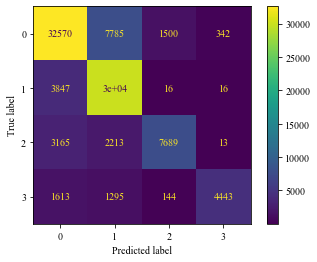

In [32]:
#Compute the confusion matrix for the random forest model's 
#predictions
from sklearn.metrics import confusion_matrix
from sklearn import metrics
confusion_mat = confusion_matrix(Predictions_Mass, Bhad_Mass_Labels)
confusion_visualized = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_mat)
confusion_visualized.plot()

In [ ]:
#Convert the predictions of the MassClassifier Forest into a onehot embedding
bhadron_masses_predictions = []
for mass in Predictions_Mass:
    bhadron_masses_predictions.append([str(mass)])
print(np.shape(bhadron_masses_predictions))
encoder = OneHotEncoder(sparse = False)
predictions = encoder.fit_transform(bhadron_masses_predictions)
predictions = np.array(predictions)
print(np.shape(predictions))

(96657, 1)
(96657, 4)


In [33]:
print(onehot.shape)

(96657, 4)


In [ ]:
#Evaulates the performance of the model's predictions across the different models.
from sklearn.metrics import classification_report
target_names = ["Mass_0", "Mass_1", "Mass_2", "Mass_3"]
print(classification_report(onehot, predictions, target_names=target_names))

              precision    recall  f1-score   support

      Mass_0       0.77      0.79      0.78     41195
      Mass_1       0.89      0.73      0.80     41299
      Mass_2       0.59      0.82      0.69      9349
      Mass_3       0.59      0.92      0.72      4814

   micro avg       0.77      0.77      0.77     96657
   macro avg       0.71      0.82      0.75     96657
weighted avg       0.79      0.77      0.78     96657
 samples avg       0.77      0.77      0.77     96657



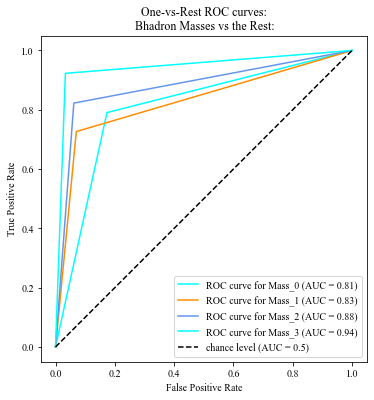

In [ ]:
import matplotlib.pyplot as plt
from itertools import cycle
from sklearn.metrics import RocCurveDisplay
target_names = ["Mass_0", "Mass_1", "Mass_2", "Mass_3", "Mass_4", "Mass_5"]
fig, ax = plt.subplots(figsize = (6,6))
colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for class_id, colors in zip(range(4), colors):
    RocCurveDisplay.from_predictions(
        onehot[:,class_id],
        predictions[:, class_id],
        name = f"ROC curve for {target_names[class_id]}",
        color = colors,
        ax = ax,
    )
plt.plot([0, 1], [0, 1], "k--", label="chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\n Bhadron Masses vs the Rest:")
plt.legend()
plt.show()

In [25]:
# Builds the deep neural network
track_layers = [32 for x in range(2)]
jet_layers = [256 for x in range(3)]
b_jets_layers = [32 for x in range(2)]

track_layers = [np.shape(Tracks_input_scaled)[2]]+track_layers
print(track_layers)
print(np.shape(onehot)[1])
#Initializers the optimizer used for training the network
optimizer = tf.keras.optimizers.Nadam(LR)

#Build a DeepSets Projection Neural Network
DeepSetProjector = DeepSetsProjection(track_layers=track_layers, b_jet_layers= b_jets_layers, jet_layers=jet_layers, n_targets=np.shape(Standardized_Bhads_targets)[1], n_targets_classification= np.shape(onehot)[1], regularizer_strength= 1e-6, n_features=np.shape(b_jets_input_scaled)[1], Dropout_rate=0.0001)

[18, 32, 32]
4


2023-02-23 09:42:46.884278: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2023-02-23 09:42:46.884312: W tensorflow/compiler/xla/stream_executor/cuda/cuda_driver.cc:265] failed call to cuInit: UNKNOWN ERROR (303)
2023-02-23 09:42:46.884328: I tensorflow/compiler/xla/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (vonneumann.csc.warwick.ac.uk): /proc/driver/nvidia/version does not exist
2023-02-23 09:42:46.886700: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [ ]:
from HffragDeepSetsProjectionMultivariateExperimental4 import DeepSetsProjection as DeepSetsProjection4
# Builds the deep neural network
track_layers = [32 for x in range(2)]
jet_layers = [256 for x in range(3)]
b_jets_layers = [32 for x in range(2)]
num_heads = 8

track_layers = [np.shape(Tracks_input_scaled)[2]]+track_layers
print(track_layers)
print(np.shape(onehot)[1])
#Initializers the optimizer used for training the network
optimizer = tf.keras.optimizers.Nadam(LR)

#Build a DeepSets Projection Neural Network
DeepSetProjector2 = DeepSetsProjection4(track_layers=track_layers, b_jet_layers= b_jets_layers, jet_layers=jet_layers,num_heads = num_heads, n_targets=np.shape(bhads_targets_clean)[1], n_targets_classification= np.shape(onehot)[1], regularizer_strength= 1e-6, n_features=np.shape(b_jets_input_scaled)[1], Dropout_rate=0.1)

[18, 32, 32]
4


In [26]:
path = "/home/physics/phujdj/WeightsSaved/ResidualDeepSets.ckpt"
checkpoint = os.path.dirname(path)
latest_DeepNet = tf.train.latest_checkpoint(checkpoint)

In [27]:
DeepSetProjector.load_weights(latest_DeepNet)

In [28]:
from DeepSetNeuralNetArchitecture import LogNormal_Loss_Function
from HffragDeepSetsProjection import Multivariate_Gaussian_Negative_Likelihood_Loss_Curve
from HffragDeepSetsProjection import Mean_Squared_Error
DeepSetProjector.compile(
 optimizer = optimizer,
 loss = {"MultivariateLoss": Multivariate_Gaussian_Negative_Likelihood_Loss_Curve, "MassOutput":tf.keras.losses.categorical_crossentropy},
 metrics = [Mean_Squared_Error]   
)

In [29]:
#Summarises the DeepSetsProjector Set Neural Network Architecture
DeepSetProjector.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, None, 18)]   0           []                               
                                                                                                  
 dense (Dense)                  (None, None, 18)     342         ['input_3[0][0]']                
                                                                                                  
 time_distributed_residual_unit  (None, None, 18)    720         ['dense[1][0]']                  
 s (TimeDistributedResidualUnit                                                                   
 s)                                                                                               
                                                                                              

In [30]:
means_original = np.load("/home/physics/phujdj/SavedNumpyFiles/means.npy")
stds_original = np.load("/home/physics/phujdj/SavedNumpyFiles/stds.npy")

In [31]:
#Evaluate the entire performance of the model
loss = DeepSetProjector.evaluate((Tracks_input_scaled,b_jets_input_scaled),(Standardized_Bhads_targets, onehot),verbose = 2)
print("The Loaded DeepNet has loss: ", loss)

Instructions for updating:
Lambda fuctions will be no more assumed to be used in the statement where they are used, or at least in the same block. https://github.com/tensorflow/tensorflow/issues/56089
Instructions for updating:
Use fn_output_signature instead
3021/3021 - 12s - loss: -6.5319e-01 - MultivariateLoss_loss: -2.6418e+00 - MassOutput_loss: 1.0828 - MultivariateLoss_Mean_Squared_Error: 0.4042 - MassOutput_Mean_Squared_Error: 0.1537 - 12s/epoch - 4ms/step
The Loaded DeepNet has loss:  [-0.6531860828399658, -2.6418001651763916, 1.0827680826187134, 0.40417250990867615, 0.15368002653121948]


In [38]:
Tracks_input_scaled.shape

(96657, 32, 18)

In [32]:
# Generates an upper triangular matrix from the variances and covariances of the predictions
def generate_covariance_matrix(mean_covariance_matrix, n_targets):
    variances = mean_covariance_matrix[n_targets:2*n_targets]
    covariances = mean_covariance_matrix[2*n_targets:]
    ones = tf.ones((n_targets,n_targets), dtype = tf.float32)
    mask_a = tf.linalg.band_part(ones, 0, -1)
    mask_b = tf.linalg.band_part(ones, 0, 0)
    mask = tf.subtract(mask_a,mask_b)
    zero = tf.constant(0, dtype = tf.float32)
    non_zero = tf.not_equal(mask,zero)
    indices = tf.where(non_zero)
    covariances = tf.sparse.SparseTensor(indices, covariances, dense_shape = tf.cast((n_targets,n_targets), dtype = tf.int64))
    covariances = tf.sparse.to_dense(covariances)
    variances = tf.linalg.diag(variances)
    uncertainties = variances + covariances
    uncertainties = uncertainties + tf.experimental.numpy.transpose(uncertainties)- tf.experimental.numpy.diag(tf.experimental.numpy.diag(uncertainties))

    return uncertainties

In [265]:
from tensorflow_probability import distributions as tfd
means_covs_matrix = np.array([[1.0,2.0,3.0,0.36,0.29,0.26,0.12,0.06,-0.13], [1.0,2.0,3.0,0.36,0.29,0.26,0.12,0.06,-0.13]])
means = means_covs_matrix[:,:3]
[[ 0.36,  0.12,  0.06],
[ 0.12,  0.29, -0.13],
[ 0.06, -0.13,  0.26]]
true = np.array([[1,2,3], [1,2,3]])
uncertainties = np.array(list(map(lambda x: tf.linalg.cholesky(generate_covariance_matrix(x, 3)), means_covs_matrix)))
print(uncertainties.shape, means.shape)
mvn1 = tfd.MultivariateNormalTriL(loc = means, scale_tril = uncertainties)
mvn1

(2, 3, 3) (2, 3)


<tfp.distributions.MultivariateNormalTriL 'MultivariateNormalTriL' batch_shape=[2] event_shape=[3] dtype=float64>

In [266]:
mvn1.covariance()

<tf.Tensor: shape=(2, 3, 3), dtype=float64, numpy=
array([[[ 0.36,  0.12,  0.06],
        [ 0.12,  0.29, -0.13],
        [ 0.06, -0.13,  0.26]],

       [[ 0.36,  0.12,  0.06],
        [ 0.12,  0.29, -0.13],
        [ 0.06, -0.13,  0.26]]])>

In [45]:
# Generates an upper triangular matrix from the variances and covariances of the predictions
def generate_triu(mean_covariance_matrix, n_targets):
    variances = mean_covariance_matrix[n_targets:2*n_targets]
    covariances = mean_covariance_matrix[2*n_targets:]

    ones = tf.ones((n_targets,n_targets), dtype = tf.float32)
    mask_a = tf.linalg.band_part(ones, 0, -1)
    mask_b = tf.linalg.band_part(ones, 0, 0)
    mask = tf.subtract(mask_a,mask_b)
    zero = tf.constant(0, dtype = tf.float32)
    non_zero = tf.not_equal(mask,zero)
    indices = tf.where(non_zero)
    covariances = tf.sparse.SparseTensor(indices, covariances, dense_shape = tf.cast((n_targets,n_targets), dtype = tf.int64))
    covariances = tf.sparse.to_dense(covariances)
    variances = tf.linalg.diag(variances)
    uncertainties = variances + covariances

    return uncertainties


In [343]:
from tensorflow_probability import distributions as tfd
means_covs_matrix = np.array([[1.0,2.0,3.0,0.36,0.29,0.26,0.12,0.06,-0.13], [1.0,2.0,3.0,0.36,0.29,0.26,0.12,0.06,-0.13]])
means = means_covs_matrix[:,:3]
[[ 0.36,  0.12,  0.06],
[ 0.12,  0.29, -0.13],
[ 0.06, -0.13,  0.26]]
true = np.array([[1,2,3], [1,2,3]])
uncertainties = np.array(list(map(lambda x: generate_triu(x, 3), means_covs_matrix)))
mvn2 = tfd.MultivariateNormalTriL(loc = means, scale_tril = uncertainties)
mvn2

<tfp.distributions.MultivariateNormalTriL 'MultivariateNormalTriL' batch_shape=[2] event_shape=[3] dtype=float64>

In [185]:
pi = tf.cast(tf.constant([np.pi]), dtype=tf.float64)
pi

<tf.Tensor: shape=(1,), dtype=float64, numpy=array([3.14159274])>

In [318]:
def multivariate_gaussian_pdf(X,MU,SIGMA):
    '''Returns the pdf of a nultivariate gaussian distribution
     - X, MU are p x 1 vectors
     - SIGMA is a p x p matrix'''
    print("hello")
    #Initialize and reshape
    X = X.reshape(-1,1)
    MU = MU.reshape(-1,1)
    p,_ = SIGMA.shape
    print("sigma ",-p/2*np.linalg.det(SIGMA))
    #Compute values
    SIGMA_inv = np.linalg.inv(SIGMA)
    denominator = np.sqrt((2 * np.pi)**p * np.linalg.det(SIGMA))
    exponent = -(1/2) * ((X - MU).T @ SIGMA_inv @ (X - MU))
    print(denominator, print(exponent))
    #Return result
    return np.log(float((1. / denominator) * np.exp(exponent)))  

In [385]:
def multivariate_gaussian_pdf_tensorflow(X,MU,SIGMA, n_targets):
    '''Returns the pdf of a nultivariate gaussian distribution
     - X, MU are p x 1 vectors
     - SIGMA is a p x p matrix'''
    #Initialize and reshape
    X = tf.cast(tf.reshape(X,[-1,1]),tf.float64)
    MU = tf.cast(tf.reshape(MU,[-1,1]),tf.float64) 
    n_targets = tf.cast(tf.shape(SIGMA)[1], tf.float64)
    SIGMA_inv = tf.linalg.inv(SIGMA)
    denominator = tf.sqrt(tf.cast((2.0 * pi)**n_targets,tf.float64) * tf.linalg.det(SIGMA))
    exponent = -(1.0/2.0) * (tf.linalg.matmul(tf.linalg.matmul(tf.transpose((X - MU)), SIGMA_inv), (X - MU)))
    print(denominator)
    print(exponent)
    #Return result
    return keras.backend.log(tf.cast(((1.0 / denominator) * tf.exp(exponent)),tf.float64))   

In [131]:
import keras
n_targets = 3

In [154]:
cov_matrix = tf.Variable(tf.ones((n_targets, n_targets), dtype = tf.float32))

def make_cov_matrix(arr, ntargets):
    n = ntargets
    sigmas = arr[:n]
    covariances = arr[n:]
    k = 0
    for i in range(n):
        cov_matrix[i,i].assign(sigmas[i])
        for j in range(i+1, n):
            cov_matrix[i,j].assign(covariances[k])
            cov_matrix[j,i].assign(cov_matrix[i,j])
            k += 1
    return cov_matrix

def mahala_dist(true, means, cov_matrices):
 ntargets = true.shape[1]
 diff = tf.subtract(true, means)
 diff = tf.reshape(diff, (ntargets, len(true)))
 diff = tf.cast(diff, dtype = tf.float32)
 invcovs = tf.cast(tf.linalg.inv(cov_matrices), dtype = tf.float32)
 mull = tf.matmul(invcovs, diff)
 mull2 = tf.matmul( tf.transpose(diff), mull)
 dist = tf.cast(mull2, dtype = tf.float32)
 return dist

def LogNormalMulti(true, meanscovs):
    ntargets = true.shape[1]
    means = meanscovs[:,:ntargets]
    sigmas = meanscovs[:,ntargets:2*ntargets]
    covs = meanscovs[:,2*ntargets]
    sigmascovs = meanscovs[:, ntargets:]
    cov_matrices = []
    for x in range(len(true)):
        cov_matrices.append(make_cov_matrix(sigmascovs[x], ntargets))
    tf.convert_to_tensor(cov_matrices)
    det_covs = tf.linalg.det(cov_matrices)
    #inv_covs = tf.linalg.inv(cov_matrix)
    #diff_matrix = true - means
    #diff_matrix = tf.reshape(diff_matrix, (ntargets, 0))
    #tran_diff_matrix = tf.linalg.matrix_transpose(diff_matrix)
    const = tf.cast(ntargets/2, dtype = tf.float32)
    logval = tf.cast(keras.backend.log(tf.maximum(det_covs, tf.constant(1e-6, dtype = tf.float32))), dtype = tf.float32)
    loss = tf.math.add((const * logval), mahala_dist(true, means, cov_matrices))
    a = (const * logval)
    b = mahala_dist(true, means, cov_matrices)
    c = const
    return a,b,c


In [282]:
print(true.reshape(-1,1), means_covs_matrix.reshape(-1,1))
LogNormalMulti(true.reshape(-1,1), means_covs_matrix.reshape(-1,1))

[[1.]
 [2.]
 [3.]] [[ 1.  ]
 [ 2.  ]
 [ 3.  ]
 [ 0.36]
 [ 0.29]
 [ 0.26]
 [ 0.12]
 [ 0.06]
 [-0.13]]


IndexError: index 2 is out of bounds for axis 1 with size 1

In [367]:
from tensorflow_probability import distributions as tfd
means_covs_matrix = means_covs_matrix
means = means_covs_matrix[:,:3]
[[ 0.36,  0.12,  0.06],
[ 0.12,  0.29, -0.13],
[ 0.06, -0.13,  0.26]]
true = np.array([[1,2,3],[1,2,3]])
print(true.shape,means_covs_matrix.shape)
uncertainties = tf.map_fn(lambda x: generate_covariance_matrix(x, 3), means_covs_matrix)
[multivariate_gaussian_pdf(true[x], means[x], uncertainties[x]) for x in range(np.shape(true)[0])]

(2, 3) (2, 9)
hello
sigma  -0.0216
[[-0.]]
1.8899531934866902 None
hello
sigma  -0.0216
[[-0.]]
1.8899531934866902 None


[-0.6365520634139272, -0.6365520634139272]

In [320]:
np.exp(-0.0216)

0.9786316094148849

In [375]:
from tensorflow_probability import distributions as tfd
#means_covs_matrix = np.array([1.0,2.0,3.0,0.36,0.29,0.26,0.12,0.06,-0.13])
#means = means_covs_matrix[:3]
[[ 0.36,  0.12,  0.06],
[ 0.12,  0.29, -0.13],
[ 0.06, -0.13,  0.26]]
#true = np.array([1,2,3])
print(means_covs_matrix)
print(generate_covariance_matrix(means_covs_matrix[0], 3))
uncertainties = np.array(list(map(lambda x: generate_covariance_matrix(x, 3), means_covs_matrix)))
multivariate_gaussian_pdf_tensorflow(true[0], means[0], uncertainties[0],3.0)
[multivariate_gaussian_pdf_tensorflow(true[x], means[x], uncertainties[x],3) for x in range(np.shape(true)[0])]

[[ 1.    2.    3.    0.36  0.29  0.26  0.12  0.06 -0.13]
 [ 1.    2.    3.    0.36  0.29  0.26  0.12  0.06 -0.13]]
tf.Tensor(
[[ 0.36  0.12  0.06]
 [ 0.12  0.29 -0.13]
 [ 0.06 -0.13  0.26]], shape=(3, 3), dtype=float64)


[<tf.Tensor: shape=(1, 1), dtype=float64, numpy=array([[-0.63655206]])>,
 <tf.Tensor: shape=(1, 1), dtype=float64, numpy=array([[-0.63655206]])>]

In [143]:
mvn1.mean(), mvn1.covariance()

(<tf.Tensor: shape=(3,), dtype=float64, numpy=array([1., 2., 3.])>,
 <tf.Tensor: shape=(3, 3), dtype=float64, numpy=
 array([[ 0.36,  0.12,  0.06],
        [ 0.12,  0.29, -0.13],
        [ 0.06, -0.13,  0.26]])>)

In [56]:
mvn2.mean(), mvn2.covariance()

(<tf.Tensor: shape=(3,), dtype=float64, numpy=array([1., 2., 3.])>,
 <tf.Tensor: shape=(3, 3), dtype=float64, numpy=
 array([[0.36, 0.  , 0.  ],
        [0.  , 0.29, 0.  ],
        [0.  , 0.  , 0.26]])>)

In [273]:
mvn1.log_prob(true)

<tf.Tensor: shape=(2,), dtype=float64, numpy=array([-0.63655206, -0.63655206])>

In [337]:
from tensorflow_probability import distributions as tfd
means_covs_matrix = np.array([1.0,2.0,3.0,0.36,0.29,0.26,0.12,0.06,-0.13])
means = means_covs_matrix[:3]
[[ 0.36,  0.12,  0.06],
[ 0.12,  0.29, -0.13],
[ 0.06, -0.13,  0.26]]
true = np.array([1,2,3])
print(generate_covariance_matrix(means_covs_matrix, 3))
uncertainties = generate_covariance_matrix(means_covs_matrix, 3)
multivariate_gaussian_pdf(true, means, uncertainties)

tf.Tensor(
[[ 0.36  0.12  0.06]
 [ 0.12  0.29 -0.13]
 [ 0.06 -0.13  0.26]], shape=(3, 3), dtype=float64)
hello
sigma  -0.0216
[[-0.]]
1.8899531934866902 None


-0.6365520634139272

In [386]:
from tensorflow_probability import distributions as tfd
means_covs_matrix = np.array([1.0,2.0,3.0,0.36,0.29,0.26,0.12,0.06,-0.13])
means = means_covs_matrix[:3]
[[ 0.36,  0.12,  0.06],
[ 0.12,  0.29, -0.13],
[ 0.06, -0.13,  0.26]]
true = np.array([1,2,3])
print(generate_covariance_matrix(means_covs_matrix, 3))
uncertainties = generate_covariance_matrix(means_covs_matrix, 3)
multivariate_gaussian_pdf_tensorflow(true, means, uncertainties,3.0)

tf.Tensor(
[[ 0.36  0.12  0.06]
 [ 0.12  0.29 -0.13]
 [ 0.06 -0.13  0.26]], shape=(3, 3), dtype=float64)
tf.Tensor([1.88995327], shape=(1,), dtype=float64)
tf.Tensor([[-0.]], shape=(1, 1), dtype=float64)


<tf.Tensor: shape=(1, 1), dtype=float64, numpy=array([[-0.63655211]])>

In [277]:
means_covs_matrix = np.array([1.0,2.0,3.0,0.36,0.29,0.26,0.12,0.06,-0.13]).reshape(1,-1)
true = np.array([1.0,2.0,3.0]).reshape(1,-1)
print(means_covs_matrix.shape)
print(true.shape)
print(means_covs_matrix.shape, true.shape)
LogNormalMulti(true, means_covs_matrix)

(1, 9)
(1, 3)
(1, 9) (1, 3)


(<tf.Tensor: shape=(1,), dtype=float32, numpy=array([-6.3607907], dtype=float32)>,
 <tf.Tensor: shape=(1, 1, 1), dtype=float32, numpy=array([[[0.]]], dtype=float32)>,
 <tf.Tensor: shape=(), dtype=float32, numpy=1.5>)

In [243]:
Predictions = np.stack([DeepSetProjector((Tracks_input_scaled, b_jets_input_scaled))[0] for sample in range(10)])
Predictions_Means = Predictions[:,:,:np.shape(Standardized_Bhads_targets)[1]]
Predictions_Uncertainty = Predictions[:,:,np.shape(Standardized_Bhads_targets)[1]:2*np.shape(Standardized_Bhads_targets)[1]]

lister = np.empty(shape=(np.shape(Predictions_Means)[0] * np.shape(Predictions_Means)[1],1))
index = 0
for bhads_features in range(np.shape(Predictions_Means)[2]):
    Predictions_temp = Predictions_Means[:, :, bhads_features]
    Predictions_temp = (Predictions_temp*stds_original[index]) + means_original[index]
    Predictions_temp = Predictions_temp.reshape(-1,1)
    lister = np.concatenate([lister,Predictions_temp], axis = -1)
    index+=1

Predictions_X = lister.reshape(np.shape(Predictions_Means)[0], np.shape(Predictions_Means)[1], -1)
Predictions_X = Predictions_X[:,:, 1:]
print(Predictions_X.shape)

lister = np.empty(shape=(np.shape(Predictions_Uncertainty)[0] * np.shape(Predictions_Uncertainty)[1],1))
index = 0
for bhads_features in range(np.shape(Predictions_Uncertainty)[2]):
    Predictions_temp = Predictions_Uncertainty[:, :, bhads_features]
    Predictions_temp = (Predictions_temp*stds_original[index]) + means_original[index]
    Predictions_temp = Predictions_temp.reshape(-1,1)
    lister = np.concatenate([lister,Predictions_temp], axis = -1)
    index+=1
Predictions_Uncertainty = lister.reshape(np.shape(Predictions_Uncertainty)[0], np.shape(Predictions_Uncertainty)[1], -1)
Predictions_Uncertainty = Predictions_Uncertainty[:,:, 1:]
print(Predictions_Uncertainty.shape)

weights = 1/Predictions_Uncertainty**2
Predictions_X = np.sum(weights*Predictions_X, axis = 0)/np.sum(weights, axis = 0)

(10, 96657, 13)
(10, 96657, 13)


In [234]:
print(predictions_x[0])

array([ 3.78504395e+04,  4.19198856e+04, -1.56186838e+05,  5.73513242e+04,
       -1.75735458e+00,  8.17787665e-01,  7.29580729e-01,  7.39675812e-01,
        7.27593618e-01,  1.67293759e+05,  5.73962629e+04,  3.14232458e+01,
        7.22925526e-01])

In [237]:
1/(Predictions_Uncertainty[0]**2)

array([[1.25746631e-08, 9.29967657e-09, 6.64150772e-10, ...,
        1.07541674e-10, 6.60172779e-04, 1.07431326e+00],
       [1.44704860e-07, 1.08661684e-08, 1.51655392e-09, ...,
        1.17763504e-10, 7.77632044e-04, 1.18677519e+00],
       [3.74363560e-09, 6.50065126e-08, 1.09082310e-08, ...,
        1.04323883e-10, 8.41399135e-04, 1.14206867e+00],
       ...,
       [1.35793605e-08, 7.58922245e-09, 1.86606935e-08, ...,
        1.06684841e-10, 8.72808388e-04, 1.15334309e+00],
       [4.72820892e-09, 7.10904813e-09, 8.32441205e-11, ...,
        9.63557299e-11, 3.71799746e-04, 1.05501394e+00],
       [5.89950921e-09, 1.17791035e-07, 2.42445792e-09, ...,
        1.09140455e-10, 8.05119198e-04, 1.04584866e+00]])

In [244]:
weights[0]

array([[1.25749027e-08, 9.30207671e-09, 6.64101700e-10, ...,
        1.07540036e-10, 6.60164367e-04, 1.07430092e+00],
       [1.44704860e-07, 1.08661684e-08, 1.51655392e-09, ...,
        1.17763504e-10, 7.77632044e-04, 1.18677519e+00],
       [3.77508138e-09, 6.49592838e-08, 1.08308337e-08, ...,
        1.04400161e-10, 8.41418314e-04, 1.14223761e+00],
       ...,
       [1.35793605e-08, 7.58922245e-09, 1.86606935e-08, ...,
        1.06684841e-10, 8.72808388e-04, 1.15334309e+00],
       [4.72820892e-09, 7.10904813e-09, 8.32441205e-11, ...,
        9.63557299e-11, 3.71799746e-04, 1.05501394e+00],
       [5.89531026e-09, 1.17775699e-07, 2.42560594e-09, ...,
        1.09141096e-10, 8.05193801e-04, 1.04582163e+00]])

In [215]:
predictions_x.shape

(13,)

In [213]:
1/(Predictions_Uncertainty

array([[8.91767871e+03, 1.03696973e+04, 3.88031211e+04, ...,
        9.64298750e+04, 3.89198532e+01, 9.64793861e-01],
       [2.62880542e+03, 9.59316211e+03, 2.56785840e+04, ...,
        9.21498516e+04, 3.58602180e+01, 9.17943120e-01],
       [1.63438066e+04, 3.92212622e+03, 9.57464844e+03, ...,
        9.79057344e+04, 3.44745789e+01, 9.35737193e-01],
       ...,
       [8.58144336e+03, 1.14789287e+04, 7.32042188e+03, ...,
        9.68163359e+04, 3.38485870e+01, 9.31152344e-01],
       [1.45429219e+04, 1.18602617e+04, 1.09603195e+05, ...,
        1.01873500e+05, 5.18615456e+01, 9.73578334e-01],
       [1.32714375e+04, 2.93152637e+03, 2.07130586e+04, ...,
        9.58204375e+04, 3.52811890e+01, 9.76051688e-01]], dtype=float32)

In [207]:
Predictions_Means = Predictions[:,:,:np.shape(Standardized_Bhads_targets)[1]]
Predictions_Uncertainty = Predictions[:,:,np.shape(Standardized_Bhads_targets)[1]:2*np.shape(Standardized_Bhads_targets)[1]]
weights = 1/(Predictions_Uncertainty**2)
predictions_x = np.sum(weights*Predictions_Means, axis = 0)/np.sum(weights, axis = 0)

In [209]:
Predictions_Uncertainty.shape

(10, 96657, 13)

In [210]:
lister = []
index = 0
for bhads_features in range(np.shape(predictions_x)[2]):
    Predictions_temp = predictions_x[:, bhads_features]
    Predictions_temp = (Predictions_temp*stds_original[index]) + means_original[index]
    Predictions_temp = Predictions_temp.reshape(-1,1)
    lister.append(Predictions_temp)
    index+=1
Predictions_X = np.concatenate(lister, axis = 1)
print(Predictions_X)

lister = []
index = 0
for bhads_features in range(np.shape(Predictions_Uncertainty)[2]):
    Predictions_temp = Predictions_Uncertainty[:, bhads_features]
    Predictions_temp = (Predictions_temp*stds_original[index]) + means_original[index]
    Predictions_temp = Predictions_temp.reshape(-1,1)
    lister.append(Predictions_temp)
    index+=1
Predictions_Uncertainty = np.concatenate(lister, axis = 1)
print(Predictions_Uncertainty)

IndexError: tuple index out of range

In [206]:
stds.shape

(13,)

In [245]:
Predictions_Uncertainty

array([[[8.91759375e+03, 1.03683594e+04, 3.88045547e+04, ...,
         9.64306094e+04, 3.89201012e+01, 9.64799404e-01],
        [2.62880542e+03, 9.59316211e+03, 2.56785840e+04, ...,
         9.21498516e+04, 3.58602180e+01, 9.17943120e-01],
        [1.62755938e+04, 3.92355176e+03, 9.60879785e+03, ...,
         9.78699609e+04, 3.44741859e+01, 9.35667992e-01],
        ...,
        [8.58144336e+03, 1.14789287e+04, 7.32042188e+03, ...,
         9.68163359e+04, 3.38485870e+01, 9.31152344e-01],
        [1.45429219e+04, 1.18602617e+04, 1.09603195e+05, ...,
         1.01873500e+05, 5.18615456e+01, 9.73578334e-01],
        [1.30240684e+04, 2.91388330e+03, 2.03043867e+04, ...,
         9.57206953e+04, 3.52411270e+01, 9.77847636e-01]],

       [[8.91767871e+03, 1.03696973e+04, 3.88031211e+04, ...,
         9.64298750e+04, 3.89198532e+01, 9.64793861e-01],
        [2.62880542e+03, 9.59316211e+03, 2.56785840e+04, ...,
         9.21498516e+04, 3.58602180e+01, 9.17943120e-01],
        [1.63775000e+04, 

In [200]:
Predictions_Uncertainty = Predictions[:,:,np.shape(Standardized_Bhads_targets)[1]:2*np.shape(Standardized_Bhads_targets)[1]]
weights = 1/(Predictions_Uncertainty**2)

In [201]:
predictions_x = np.sum(weights*Predictions_Means, axis = 0)/np.sum(weights, axis = 0)
predictions_x

array([[ 0.5793723 ,  0.64233565, -0.7796457 , ..., -0.59592974,
         0.02802394, -0.23740186],
       [ 0.28673536,  0.9643139 , -0.86022925, ..., -0.41791123,
         0.13691533,  0.5958695 ],
       [ 0.7025838 ,  0.02837298,  0.14404097, ..., -0.9268863 ,
        -0.7299975 , -1.5883685 ],
       ...,
       [ 0.92623115,  1.1917859 ,  0.2927667 , ...,  0.40159127,
        -0.29596546,  0.871458  ],
       [ 0.66050833, -0.484249  , -1.470348  , ..., -0.67650586,
         0.9470451 , -0.8854313 ],
       [-0.6998633 , -0.07159448, -0.35280895, ..., -0.8130171 ,
        -0.49164546, -0.34912208]], dtype=float32)

In [87]:
covariance_matrices = np.empty(shape = (1,13,13))
for sample in range(len(Predictions)):
    covariance_matrices = np.append(covariance_matrices,tf.map_fn(lambda x: generate_covariance_matrix(x, 13), Predictions[sample], dtype = tf.float32), axis = 0)

(13, 13)

In [275]:
covariance_matrices_unscaled[0]

array([[[ 5.88095985e+08, -2.31088750e+09,  3.66009881e+09, ...,
          3.11130286e+08, -1.35576067e+06,  7.02668120e+03],
        [-2.31088750e+09,  6.78583585e+08, -1.29379930e+10, ...,
         -4.52053291e+09, -8.76140318e+05,  1.02057399e+04],
        [ 3.66009881e+09, -1.29379930e+10,  7.75894729e+09, ...,
          8.75158037e+09,  1.04276161e+07,  4.62446840e+04],
        ...,
        [ 3.11130286e+08, -4.52053291e+09,  8.75158037e+09, ...,
          5.86855602e+08,  1.33065178e+06,  3.41009862e+03],
        [-1.35576067e+06, -8.76140318e+05,  1.04276161e+07, ...,
          1.33065178e+06,  2.31519601e+02,  1.23287221e+00],
        [ 7.02668120e+03,  1.02057399e+04,  4.62446840e+04, ...,
          3.41009862e+03,  1.23287221e+00,  4.51833662e-02]],

       [[ 1.76788758e+08, -3.32575434e+09,  5.88704510e+09, ...,
          8.12506730e+08, -1.15140448e+06,  4.05881212e+03],
        [-3.32575434e+09,  6.27909307e+08, -9.96585954e+09, ...,
         -3.71508650e+09, -7.53473093e

In [298]:
variances_matrix = np.empty([len(Predictions),len(Standardized_Bhads_targets),13,13])
variances_matrix.shape
for index_i in range(np.shape(variances_matrix)[2]):
    for index_j in range(np.shape(variances_matrix)[3]):
        variances_matrix[:, :, index_i, index_j] = np.sqrt(stds[index_i]*stds[index_j])
print(variances_matrix.shape)

(10, 96657, 13, 13)


In [299]:
covariance_matrices_true[0]

array([[[ 0.13729511, -0.54073644,  0.2798087 , ...,  0.11273433,
         -0.73864609,  0.43583056],
        [-0.54073644,  0.15915129, -0.99136889, ..., -1.64173663,
         -0.47843948,  0.63447118],
        [ 0.2798087 , -0.99136889,  0.19423735, ...,  1.03839338,
          1.86037266,  0.93927073],
        ...,
        [ 0.11273433, -1.64173663,  1.03839338, ...,  0.33002904,
          1.12518728,  0.32827771],
        [-0.73864609, -0.47843948,  1.86037266, ...,  1.12518728,
          0.294366  ,  0.17845635],
        [ 0.43583056,  0.63447118,  0.93927073, ...,  0.32827771,
          0.17845635,  0.74457181]],

       [[ 0.04127257, -0.77821034,  0.45005518, ...,  0.29440206,
         -0.62730867,  0.2517482 ],
        [-0.77821034,  0.14726642, -0.76363027, ..., -1.34922004,
         -0.41145381,  0.57977945],
        [ 0.45005518, -0.76363027,  0.12867974, ...,  0.64635903,
          2.22716498,  0.75120974],
        ...,
        [ 0.29440206, -1.34922004,  0.64635903, ...,  

In [ ]:
covariance_matrices_true = covariance_matrices[1:].reshape(10,96657,13,13)

In [301]:
covariance_matrices_unscaled = covariance_matrices_true*variances_matrix
covariance_matrices_unscaled.shape

array([[[ 8.98569441e+03, -3.53494140e+04,  3.20019920e+04, ...,
          5.92242035e+03, -1.00071340e+03,  5.53393389e+01],
        [-3.53494140e+04,  1.03921822e+04, -1.13253361e+05, ...,
         -8.61482701e+04, -6.47441208e+02,  8.04689245e+01],
        [ 3.20019920e+04, -1.13253361e+05,  3.88210944e+04, ...,
          9.53288157e+04,  4.40445819e+03,  2.08413719e+02],
        ...,
        [ 5.92242035e+03, -8.61482701e+04,  9.53288157e+04, ...,
          1.39168743e+04,  1.22361450e+03,  3.34583226e+01],
        [-1.00071340e+03, -6.47441208e+02,  4.40445819e+03, ...,
          1.22361450e+03,  8.25539213e+00,  4.69056368e-01],
        [ 5.53393389e+01,  8.04689245e+01,  2.08413719e+02, ...,
          3.34583226e+01,  4.69056368e-01,  1.83418267e-01]],

       [[ 2.70120830e+03, -5.08737302e+04,  5.14732470e+04, ...,
          1.54662102e+04, -8.49874113e+02,  3.19655856e+01],
        [-5.08737302e+04,  9.61612991e+03, -8.72366438e+04, ...,
         -7.07987934e+04, -5.56793837e

In [304]:
covariances = covariance_matrices_unscaled.mean(axis = 0)

In [179]:
weights[1]

array([1.4470486e-07, 1.0866168e-08, 1.5165539e-09, 1.1794603e-10,
       3.1963533e+03, 2.4828533e+03, 1.0996798e+00, 1.1854566e+00,
       1.1908774e+00, 2.7698174e-11, 1.1776351e-10, 7.7763206e-04,
       1.1867752e+00], dtype=float32)

In [248]:
covariances = covariance_matrices_unscaled.mean(axis = 0)

In [276]:
np.shape(covariances)

(96657, 13, 13)

In [249]:
predictions_covariances = np.sum(weights.reshape(10,96657,13,1) * covariance_matrices_unscaled, axis = 0)

In [250]:
predictions_covariances[0]

array([[ 7.39512295e+01, -2.90586871e+02,  4.60245970e+02,
        -4.89593960e+01,  1.17112123e-02, -2.33451014e-02,
         7.56822710e-02,  1.91303386e+00,  2.76729605e-02,
         5.26089028e+01,  3.91236597e+01, -1.70482661e-01,
         8.83583170e-04],
       [-2.14910610e+02,  6.31077073e+01, -1.20322256e+03,
        -7.27283334e+01, -9.07116949e-03, -8.81440263e-04,
         3.44768837e-02,  4.41795747e-01,  1.71567269e-02,
        -4.27615904e+02, -4.20405789e+02, -8.14803187e-02,
         9.49125297e-04],
       [ 2.43083949e+01, -8.59271455e+01,  5.15307276e+01,
        -2.27750599e+01,  2.44410830e-04, -3.07705504e-03,
        -2.42756347e-02,  1.13525855e-01, -2.38132924e-03,
         7.21768762e+01,  5.81232592e+01,  6.92545811e-02,
         3.07132157e-04],
       [-4.18582246e-01, -8.40749310e-01, -3.68670164e+00,
         6.43351234e-01,  1.03905910e-04, -9.03639532e-05,
        -3.57593672e-04,  1.08446687e-03,  2.83588678e-04,
        -8.77643733e+00, -1.20882827e

In [98]:
covariance_matrices_true = covariance_matrices[1:].reshape(10,96657,13,13)

In [432]:
covariance_matrices_true[0].shape

(96657, 13, 13)

In [99]:
covariance_matrices_true.shape

(10, 96657, 13, 13)

In [191]:
weights[0]

array([1.2574663e-08, 9.2996766e-09, 6.6415079e-10, 1.0750830e-10,
       3.5345020e+02, 3.8324573e+02, 1.0596476e+00, 1.0628563e+00,
       1.0869424e+00, 2.3699497e-11, 1.0754168e-10, 6.6017278e-04,
       1.0743133e+00], dtype=float32)

In [105]:
covariances = np.sum(weights.reshape(10,96657,13,1)**2 * covariance_matrices_true, axis = 0)

In [280]:
variances_matrix = np.empty([len(Standardized_Bhads_targets),13,13])
variances_matrix.shape
for index_i in range(np.shape(variances_matrix)[1]):
    for index_j in range(np.shape(variances_matrix)[2]):
        variances_matrix[:, index_i, index_j] = np.sqrt(stds[index_i]*stds[index_j])
print(variances_matrix.shape)

(96657, 13, 13)


In [117]:
np.sqrt(stds[0]*stds[0])

65448.028575277414

In [155]:
variances_matrix[0,0,0]

65448.028575277414

In [181]:
covariance_matrix_unscaled = covariances*variances_matrix
covariance_matrix_unscaled.shape

(96657, 13, 13)

In [305]:
Predictions_Uncertainty = np.array([np.diag(x) for x in covariances])
Predictions_Uncertainty.shape

(96657, 13)

In [306]:
Predictions_Uncertainty[0]

array([8.98569441e+03, 1.03921822e+04, 3.88210944e+04, 1.41561272e+04,
       5.38788385e-02, 4.85225666e-02, 8.76009030e+00, 6.36285868e+01,
       1.69836982e+00, 4.27034542e+04, 1.39168743e+04, 8.25539213e+00,
       1.83418267e-01])

In [279]:
Predictions_Uncertainty[0]

array([5.88095985e+08, 6.78583585e+08, 7.75894729e+09, 5.98420140e+08,
       6.60802246e-02, 8.80735911e-02, 1.29923519e+02, 7.05436347e+03,
       5.16224021e+00, 6.35616711e+09, 5.86855602e+08, 2.31519601e+02,
       4.51833662e-02])

In [257]:
Predictions_Uncertainty = np.array([np.diag(x) for x in covariances])
Predictions_Uncertainty.shape

(96657, 13)

In [195]:
predictions_x

array([ 7.9023303e+02,  9.5742108e+02, -5.9937378e+02,  7.9170359e+04,
       -4.0231910e-02, -7.7158853e-02,  7.9844010e-01,  7.9778397e-01,
        7.9296583e-01,  1.3719784e+05,  7.9184023e+04,  2.5893143e+01,
        7.9214990e-01], dtype=float32)

In [134]:
lister = []
index = 0
for bhads_features in range(np.shape(predictions_x)[1]):
    Predictions_temp = predictions_x[:, bhads_features]
    Predictions_temp = (Predictions_temp*stds_original[index]) + means_original[index]
    Predictions_temp = Predictions_temp.reshape(-1,1)
    lister.append(Predictions_temp)
    index+=1
Predictions_X = np.concatenate(lister, axis = 1)
print(Predictions_X)

lister = []
index = 0
print(predictions_x_uncertainty)
for bhads_features in range(np.shape(predictions_x_uncertainty)[1]):
    Predictions_temp = predictions_x_uncertainty[:, bhads_features]
    Predictions_temp = (Predictions_temp*stds_original[index]) + means_original[index]
    Predictions_temp = Predictions_temp.reshape(-1,1)
    lister.append(Predictions_temp)
    index+=1
Predictions_Uncertainty = np.concatenate(lister, axis = 1)
print(Predictions_Uncertainty)

[[ 3.7851578e+04  4.1920426e+04 -1.5618514e+05 ...  5.7396922e+04
   3.1423168e+01  7.2294235e-01]
 [ 1.8764840e+04  6.2963406e+04 -1.7252230e+05 ...  6.4974398e+04
   3.4515942e+01  9.2877418e-01]
 [ 4.5931098e+04  1.8297566e+03  2.8747322e+04 ...  4.3400996e+04
   1.0148832e+01  3.9182132e-01]
 ...
 [ 6.0600066e+04  7.7852898e+04  5.8561828e+04 ...  9.9487227e+04
   2.2350513e+01  9.9602473e-01]
 [ 4.3161527e+04 -3.1628748e+04 -2.9427272e+05 ...  5.3952344e+04
   5.7208145e+01  5.6460923e-01]
 [-4.5927176e+04 -4.6579229e+03 -7.0874258e+04 ...  4.8188477e+04
   1.6826727e+01  6.9657630e-01]]
[[2.52889821e+08 1.61981771e+08 2.72732405e+08 ... 1.17309487e+07
  1.09947952e+04 5.96782726e+00]
 [9.31097853e+09 2.04520895e+08 9.38330783e+08 ... 3.53390748e+07
  4.40231861e+04 1.45129122e+01]
 [4.15709585e+07 2.95549822e+09 1.78164343e+10 ... 8.67560885e+06
  1.11430334e+05 1.00374012e+01]
 ...
 [2.83614832e+08 1.19517557e+08 3.95326401e+10 ... 1.08050837e+07
  1.90523033e+05 1.09844706e+01]

In [136]:
predictions_x.shape

(96657, 13)

In [108]:
print(stds.shape)

(13,)


In [ ]:
predictions = DeepSetProjector.predict((Tracks_input_scaled, b_jets_input_scaled))[0] 

In [81]:
covariance_matrices = np.array(list(map(lambda x: generate_covariance_matrix(x, 13), predictions)))
covariance_matrices.shape

(96657, 13, 13)

In [430]:
covariance_matrices.shape

(966571, 13, 13)

In [ ]:
predictions_Uncertainty = 
weight = (1/Predictions_Uncertainty)**2

In [60]:
matrix = np.transpose(results[0])
for row in results[0]:
    print("|", end = "")
    for column in row:
        print(round(column,1), end = " ")
    print("|\n")

|0.1 -0.5 0.3 -0.1 1.2 -1.6 0.6 2.1 1.1 0.0 0.1 -0.7 0.4 |

|0.0 0.2 -1.0 -0.3 -1.2 -0.1 0.4 0.7 0.9 -0.5 -1.6 -0.5 0.6 |

|0.0 0.0 0.2 -0.4 0.2 -1.3 -1.2 0.8 -0.6 0.4 1.0 1.9 0.9 |

|0.0 0.0 0.0 0.3 1.9 -1.1 -0.5 0.2 2.1 -1.3 -0.6 -0.6 0.5 |

|0.0 0.0 0.0 0.0 0.0 0.8 0.8 -0.1 -0.2 1.0 0.5 -0.3 1.1 |

|0.0 0.0 0.0 0.0 0.0 0.0 2.0 -1.1 0.0 -0.6 -0.4 1.1 -0.9 |

|0.0 0.0 0.0 0.0 0.0 0.0 0.6 1.1 -2.0 1.1 -0.9 0.8 1.1 |

|0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.6 0.7 -0.1 -1.4 0.4 -0.3 |

|0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.6 -1.6 -1.1 -0.8 -1.1 |

|0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.3 1.6 -0.6 0.6 |

|0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.3 1.1 0.3 |

|0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.3 0.2 |

|0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.0 0.7 |



In [62]:
Matrix = results[0]
X = Matrix + Matrix.T - np.diag(np.diag(Matrix))

In [66]:
np.diag(Matrix)

array([0.13730615, 0.158984  , 0.19432588, 0.334835  , 0.04394214,
       0.02674344, 0.5910039 , 0.5740819 , 0.5583647 , 0.28688633,
       0.3299437 , 0.29434845, 0.74446285], dtype=float32)

In [67]:
np.diag(X)

array([0.13730615, 0.158984  , 0.19432588, 0.334835  , 0.04394214,
       0.02674344, 0.5910039 , 0.5740819 , 0.5583647 , 0.28688633,
       0.3299437 , 0.29434845, 0.74446285], dtype=float32)

In [64]:
matrix = np.transpose(X)
for row in X:
    print("|", end = "")
    for column in row:
        print(round(column,1), end = " ")
    print("|\n")

|0.1 -0.5 0.3 -0.1 1.2 -1.6 0.6 2.1 1.1 0.0 0.1 -0.7 0.4 |

|-0.5 0.2 -1.0 -0.3 -1.2 -0.1 0.4 0.7 0.9 -0.5 -1.6 -0.5 0.6 |

|0.3 -1.0 0.2 -0.4 0.2 -1.3 -1.2 0.8 -0.6 0.4 1.0 1.9 0.9 |

|-0.1 -0.3 -0.4 0.3 1.9 -1.1 -0.5 0.2 2.1 -1.3 -0.6 -0.6 0.5 |

|1.2 -1.2 0.2 1.9 0.0 0.8 0.8 -0.1 -0.2 1.0 0.5 -0.3 1.1 |

|-1.6 -0.1 -1.3 -1.1 0.8 0.0 2.0 -1.1 0.0 -0.6 -0.4 1.1 -0.9 |

|0.6 0.4 -1.2 -0.5 0.8 2.0 0.6 1.1 -2.0 1.1 -0.9 0.8 1.1 |

|2.1 0.7 0.8 0.2 -0.1 -1.1 1.1 0.6 0.7 -0.1 -1.4 0.4 -0.3 |

|1.1 0.9 -0.6 2.1 -0.2 0.0 -2.0 0.7 0.6 -1.6 -1.1 -0.8 -1.1 |

|0.0 -0.5 0.4 -1.3 1.0 -0.6 1.1 -0.1 -1.6 0.3 1.6 -0.6 0.6 |

|0.1 -1.6 1.0 -0.6 0.5 -0.4 -0.9 -1.4 -1.1 1.6 0.3 1.1 0.3 |

|-0.7 -0.5 1.9 -0.6 -0.3 1.1 0.8 0.4 -0.8 -0.6 1.1 0.3 0.2 |

|0.4 0.6 0.9 0.5 1.1 -0.9 1.1 -0.3 -1.1 0.6 0.3 0.2 0.7 |



In [ ]:
np.diag(X)

In [147]:
Predictions = np.stack([DeepSetProjector((Tracks_input_scaled, b_jets_input_scaled))[0] for sample in range(100)])
Predictions = Predictions.mean(axis = 0)

lister = []
index = 0
predictions_x = Predictions[:,:np.shape(Standardized_Bhads_targets)[1]]
for bhads_features in range(np.shape(predictions_x)[1]):
    Predictions_temp = predictions_x[:, bhads_features]
    Predictions_temp = (Predictions_temp*stds_original[index]) + means_original[index]
    Predictions_temp = Predictions_temp.reshape(-1,1)
    lister.append(Predictions_temp)
    index+=1
Predictions_X = np.concatenate(lister, axis = 1)
print(Predictions_X)

lister = []
index = 0
predictions_x_uncertainty = Predictions[:,np.shape(Standardized_Bhads_targets)[1]:2*np.shape(Standardized_Bhads_targets)[1]]
print(predictions_x_uncertainty)
for bhads_features in range(np.shape(predictions_x_uncertainty)[1]):
    Predictions_temp = predictions_x_uncertainty[:, bhads_features]
    Predictions_temp = (Predictions_temp*stds_original[index]) + means_original[index]
    Predictions_temp = Predictions_temp.reshape(-1,1)
    lister.append(Predictions_temp)
    index+=1
Predictions_Uncertainty = np.concatenate(lister, axis = 1)
print(Predictions_Uncertainty)

[[ 3.7845266e+04  4.1912344e+04 -1.5615528e+05 ...  5.7384516e+04
   3.1427734e+01  7.2283781e-01]
 [ 1.8763375e+04  6.2979059e+04 -1.7247536e+05 ...  6.5001617e+04
   3.4498512e+01  9.2876559e-01]
 [ 4.5929906e+04  1.8337181e+03  2.8737201e+04 ...  4.3424258e+04
   1.0155788e+01  3.9199430e-01]
 ...
 [ 6.0596547e+04  7.7869070e+04  5.8597629e+04 ...  9.9485570e+04
   2.2347128e+01  9.9608171e-01]
 [ 4.3149035e+04 -3.1638680e+04 -2.9426778e+05 ...  5.3955648e+04
   5.7213814e+01  5.6457448e-01]
 [-4.5925191e+04 -4.7159121e+03 -7.0712484e+04 ...  4.8222598e+04
   1.6850220e+01  6.9635457e-01]]
[[0.1372747  0.159158   0.1942117  ... 0.32979557 0.2942404  0.7442457 ]
 [0.04131736 0.14723739 0.12895231 ... 0.2284622  0.18533811 0.55332965]
 [0.25077552 0.06045469 0.04825491 ... 0.36506787 0.1360593  0.6263369 ]
 ...
 [0.13220243 0.1761277  0.03700697 ... 0.33922553 0.11377675 0.60767627]
 [0.22319032 0.18192682 0.547789   ... 0.45919305 0.75535476 0.7804683 ]
 [0.19993927 0.04504432 0.1018

In [31]:
Predictions = np.stack([DeepSetProjector((Tracks_input_scaled, b_jets_input_scaled))[0] for _ in range(100)])
Predictions_Means = Predictions[:,:,:np.shape(Standardized_Bhads_targets)[1]]
Predictions_Uncertainty = Predictions[:,:,np.shape(Standardized_Bhads_targets)[1]:2*np.shape(Standardized_Bhads_targets)[1]]
weights = 1/Predictions_Uncertainty**2
predictions_x = np.sum(weights*Predictions_Means, axis = 0)/np.sum(weights, axis = 0)
print(predictions_x.shape)
predictions_x_uncertainty = 1/np.sqrt(np.sum(1/Predictions_Uncertainty**2, axis = 0))
print(predictions_x_uncertainty.shape)

lister = []
index = 0
#predictions_x = Predictions[:,:np.shape(Standardized_Bhads_targets)[1]]
for bhads_features in range(np.shape(predictions_x)[1]):
    Predictions_temp = predictions_x[:, bhads_features]
    Predictions_temp = (Predictions_temp*stds_original[index]) + means_original[index]
    Predictions_temp = Predictions_temp.reshape(-1,1)
    lister.append(Predictions_temp)
    index+=1
Predictions_X = np.concatenate(lister, axis = 1)
print(Predictions_X)

lister = []
index = 0
#predictions_x_uncertainty = Predictions[:,np.shape(Standardized_Bhads_targets)[1]:2*np.shape(Standardized_Bhads_targets)[1]]
print(predictions_x_uncertainty)
for bhads_features in range(np.shape(predictions_x_uncertainty)[1]):
    Predictions_temp = predictions_x_uncertainty[:, bhads_features]
    Predictions_temp = (Predictions_temp*stds_original[index]) + means_original[index]
    Predictions_temp = Predictions_temp.reshape(-1,1)
    lister.append(Predictions_temp)
    index+=1
Predictions_Uncertainty = np.concatenate(lister, axis = 1)
print(Predictions_Uncertainty)

(96657, 13)
(96657, 13)
[[ 3.7852188e+04  4.1923852e+04 -1.5619350e+05 ...  5.7395633e+04
   3.1426147e+01  7.2294569e-01]
 [ 1.8754166e+04  6.2968852e+04 -1.7251597e+05 ...  6.4980734e+04
   3.4519001e+01  9.2878479e-01]
 [ 4.5935387e+04  1.8279937e+03  2.8713100e+04 ...  4.3415215e+04
   1.0152811e+01  3.9199567e-01]
 ...
 [ 6.0602465e+04  7.7861133e+04  5.8570703e+04 ...  9.9487625e+04
   2.2352650e+01  9.9605840e-01]
 [ 4.3113117e+04 -3.1645078e+04 -2.9415122e+05 ...  5.3928824e+04
   5.7181374e+01  5.6457818e-01]
 [-4.5912082e+04 -4.7131699e+03 -7.0730711e+04 ...  4.8233906e+04
   1.6852636e+01  6.9636631e-01]]
[[0.01373252 0.01591113 0.01940943 ... 0.03300254 0.02942716 0.07444344]
 [0.0041244  0.01472028 0.01287    ... 0.0228601  0.01853852 0.05537722]
 [0.02507093 0.00604585 0.00482108 ... 0.0365115  0.01360571 0.06261282]
 ...
 [0.01321732 0.01761205 0.00369764 ... 0.03391909 0.01137671 0.06075202]
 [0.0223223  0.01818298 0.0547497  ... 0.04588823 0.07549376 0.07805923]
 [0.02

In [41]:
Predictions = np.stack([DeepSetProjector((Tracks_input_scaled, b_jets_input_scaled))[0] for _ in range(100)])
Predictions_Means = Predictions[:,:,:np.shape(Standardized_Bhads_targets)[1]]
Predictions_Uncertainty = Predictions[:,:,np.shape(Standardized_Bhads_targets)[1]:2*np.shape(Standardized_Bhads_targets)[1]]
Predictions_Covariances = Predictions[:,:,2*np.shape(Standardized_Bhads_targets)[1]:]
predictions_x, predictions_x_uncertainty = np.average(Predictions_Means, weights = (1/Predictions_Uncertainty)**2, returned = True, axis = 0)
predictions_x_uncertainty = np.sqrt(1/predictions_x_uncertainty)

lister = []
index = 0
#predictions_x = Predictions[:,:np.shape(Standardized_Bhads_targets)[1]]
for bhads_features in range(np.shape(predictions_x)[1]):
    Predictions_temp = predictions_x[:, bhads_features]
    Predictions_temp = (Predictions_temp*stds_original[index]) + means_original[index]
    Predictions_temp = Predictions_temp.reshape(-1,1)
    lister.append(Predictions_temp)
    index+=1
Predictions_X = np.concatenate(lister, axis = 1)
print(Predictions_X)

lister = []
index = 0
#predictions_x_uncertainty = Predictions[:,np.shape(Standardized_Bhads_targets)[1]:2*np.shape(Standardized_Bhads_targets)[1]]
print(predictions_x_uncertainty)
for bhads_features in range(np.shape(predictions_x_uncertainty)[1]):
    Predictions_temp = predictions_x_uncertainty[:, bhads_features]
    Predictions_temp = (Predictions_temp*stds_original[index]) + means_original[index]
    Predictions_temp = Predictions_temp.reshape(-1,1)
    lister.append(Predictions_temp)
    index+=1
Predictions_Uncertainty = np.concatenate(lister, axis = 1)
print(Predictions_Uncertainty)

[[ 3.7843793e+04  4.1930605e+04 -1.5616605e+05 ...  5.7395191e+04
   3.1421494e+01  7.2291160e-01]
 [ 1.8764656e+04  6.2964473e+04 -1.7254469e+05 ...  6.4966523e+04
   3.4518513e+01  9.2878717e-01]
 [ 4.5939164e+04  1.8228699e+03  2.8756658e+04 ...  4.3418512e+04
   1.0152634e+01  3.9198878e-01]
 ...
 [ 6.0587598e+04  7.7864797e+04  5.8564422e+04 ...  9.9492656e+04
   2.2351974e+01  9.9592775e-01]
 [ 4.3142152e+04 -3.1633775e+04 -2.9425181e+05 ...  5.3943961e+04
   5.7203438e+01  5.6448948e-01]
 [-4.5916668e+04 -4.7006265e+03 -7.0717156e+04 ...  4.8230328e+04
   1.6850597e+01  6.9643795e-01]]
[[0.01372239 0.01591879 0.01941813 ... 0.0329891  0.02942885 0.0744446 ]
 [0.00412667 0.01472775 0.01286712 ... 0.02284946 0.01853989 0.05538378]
 [0.02507335 0.00604762 0.00482509 ... 0.03650891 0.01360782 0.06262837]
 ...
 [0.01321529 0.01760824 0.00369858 ... 0.03391606 0.01137563 0.06075364]
 [0.0223139  0.01820792 0.0547765  ... 0.045915   0.07552661 0.07805124]
 [0.02001518 0.00450568 0.0101

In [126]:
Predictions_X.shape

(1040, 13)

In [74]:
Predictions = np.stack([DeepSetProjector((Tracks_input_scaled, b_jets_input_scaled))[0] for _ in range(100)])

lister = []
index = 0
#predictions_x = Predictions[:,:np.shape(Standardized_Bhads_targets)[1]]
for bhads_features in range(np.shape(predictions_x)[1]):
    Predictions_temp = predictions_x[:, bhads_features]
    Predictions_temp = (Predictions_temp*stds_original[index]) + means_original[index]
    Predictions_temp = Predictions_temp.reshape(-1,1)
    lister.append(Predictions_temp)
    index+=1
Predictions_X = np.concatenate(lister, axis = 1)
print(Predictions_X)
"""
lister = []
index = 0
#predictions_x_uncertainty = Predictions[:,np.shape(Standardized_Bhads_targets)[1]:2*np.shape(Standardized_Bhads_targets)[1]]
print(predictions_x_uncertainty)
for bhads_features in range(np.shape(predictions_x_uncertainty)[1]):
    Predictions_temp = predictions_x_uncertainty[:, bhads_features]
    Predictions_temp = (Predictions_temp*stds_original[index]) + means_original[index]
    Predictions_temp = Predictions_temp.reshape(-1,1)
    lister.append(Predictions_temp)
    index+=1
Predictions_Uncertainty = np.concatenate(lister, axis = 1)
print(Predictions_Uncertainty)
"""

[[ 3.7840863e+04  4.1925105e+04 -1.5617286e+05 ...  5.7394000e+04
   3.1422333e+01  7.2293890e-01]
 [ 1.8753619e+04  6.2954062e+04 -1.7256247e+05 ...  6.4973094e+04
   3.4524673e+01  9.2874134e-01]
 [ 4.5926434e+04  1.8320645e+03  2.8775258e+04 ...  4.3417656e+04
   1.0154968e+01  3.9196143e-01]
 ...
 [ 6.0543520e+04  7.7822742e+04  5.8651930e+04 ...  9.9499055e+04
   2.2371267e+01  9.9602944e-01]
 [ 4.3159848e+04 -3.1625414e+04 -2.9430656e+05 ...  5.3941242e+04
   5.7214050e+01  5.6456345e-01]
 [-4.5905125e+04 -4.7013984e+03 -7.0694148e+04 ...  4.8222734e+04
   1.6845360e+01  6.9622958e-01]]


'\nlister = []\nindex = 0\n#predictions_x_uncertainty = Predictions[:,np.shape(Standardized_Bhads_targets)[1]:2*np.shape(Standardized_Bhads_targets)[1]]\nprint(predictions_x_uncertainty)\nfor bhads_features in range(np.shape(predictions_x_uncertainty)[1]):\n    Predictions_temp = predictions_x_uncertainty[:, bhads_features]\n    Predictions_temp = (Predictions_temp*stds_original[index]) + means_original[index]\n    Predictions_temp = Predictions_temp.reshape(-1,1)\n    lister.append(Predictions_temp)\n    index+=1\nPredictions_Uncertainty = np.concatenate(lister, axis = 1)\nprint(Predictions_Uncertainty)\n'

In [88]:
Deep = DeepSetProjector((Tracks_input_scaled, b_jets_input_scaled))[0]

In [86]:
# Generates an upper triangular matrix from the variances and covariances of the predictions
def generate_triu(mean_covariance_matrix, n_targets):
    variances = mean_covariance_matrix[n_targets:2*n_targets]
    covariances = mean_covariance_matrix[2*n_targets:]
    print(variances.shape, covariances.shape)
    ones = tf.ones((n_targets,n_targets), dtype = tf.float32)
    mask_a = tf.linalg.band_part(ones, 0, -1)
    mask_b = tf.linalg.band_part(ones, 0, 0)
    mask = tf.subtract(mask_a,mask_b)
    zero = tf.constant(0, dtype = tf.float32)
    non_zero = tf.not_equal(mask,zero)
    indices = tf.where(non_zero)
    covariances = tf.sparse.SparseTensor(indices, covariances, dense_shape = tf.cast((n_targets,n_targets), dtype = tf.int64))
    covariances = tf.sparse.to_dense(covariances)
    variances = tf.linalg.diag(variances)
    uncertainties = variances + covariances
    return uncertainties

In [50]:
generate_triu(Deep,n_targets=13)

NameError: name 'Deep' is not defined

In [83]:
Predictions_Means = Predictions[:,:,:np.shape(Standardized_Bhads_targets)[1]]
Predictions_Uncertainty = Predictions[:,:,np.shape(Standardized_Bhads_targets)[1]: 2*np.shape(Standardized_Bhads_targets)[1]]
Predictions_Covariances = Predictions[:,:,np.shape(Standardized_Bhads_targets)[1]:]
weight = (1/Predictions_Uncertainty)**2
print(weight.)
predictions_x, weights = np.average(Predictions_Means, weights = (1/Predictions_Uncertainty)**2, returned = True, axis = 0)
Predictions_Covariances_Adjusted = np.sum(weight**2 * Predictions_Covariances)

(100, 96657, 13)


ValueError: operands could not be broadcast together with shapes (1256541,1) (96657,91) 

In [49]:
np.shape(Standardized_Bhads_targets)[1]

13

In [72]:
weights.shape

(96657, 13)

In [71]:
weights.reshape(-1,1).shape

(1256541, 1)

In [64]:
Predictions_Covariance_Matrix.shape

(100, 13, 100, 13)

In [57]:
np.shape(xm), np.shape(weights)

((100, 96657, 13), (96657, 13))

In [53]:
n_targets = 13
print(predictions_x_uncertainty.shape)
print(Predictions_Covariances.shape)

(96657, 13)
(100, 96657, 78)


In [52]:
counts = 0
Predictions_Unscaled_Covariances = np.copy(Predictions_Covariances)
for index_i in range(n_targets):
    for index_j in range(1,n_targets-index_i):
        print(index_i, index_j)
        counts+=1
        Predictions_Unscaled_Covariances = predictions_x_uncertainty[:,index_i] * predictions_x_uncertainty[:,index_j] * Predictions_Covariances[:, index_i*n_targets + index_j]

0 1


ValueError: operands could not be broadcast together with shapes (96657,) (100,78) 

In [51]:
print(counts)

78


In [205]:
DeepSetProjector((Tracks_input_scaled, b_jets_input_scaled))[0].shape

TensorShape([96657, 104])

In [155]:
Predictions_Uncertainty[0,0]*Predictions_Uncertainty

679718.5271144509

In [172]:
(169-26)

143

In [204]:
Predictions.shape

(100, 96657, 104)

In [161]:
Predictions = np.stack([DeepSetProjector((Tracks_input_scaled, b_jets_input_scaled))[0] for _ in range(100)])
Predictions_Covariances = Predictions[:,:,2*np.shape(Standardized_Bhads_targets)[1]:]

TypeError: slice indices must be integers or None or have an __index__ method

In [173]:
Predictions_Covariances = Predictions[:,:,2*np.shape(Standardized_Bhads_targets)[1]:]

In [174]:
Predictions_Covariances.shape

(100, 96657, 78)

In [175]:
2*np.shape(Standardized_Bhads_targets)[1]
n_targets = 13

In [177]:
((13*13) - 13)/2

78.0

In [176]:
n_targets*(n_targets-1)/2

78.0

In [183]:
Predictions_Uncertainty[0,0] * Predictions_Uncertainty[0,2]


3136452.0

In [211]:
predictions_variance_matrix.shape

(96657, 169)

In [222]:
predictions_variance_matrix = np.array([np.triu(np.outer(X,X.T), 1).flatten() for X in Predictions_Uncertainty])
predictions_variance_matrix.shape

(96657, 169)

In [225]:
print(predictions_variance_matrix[0].shape)

(169,)


In [228]:
print(Predictions_Covariances[0].shape)

(96657, 78)


In [206]:
means_covariance_matrix = np.concatenate([predictions_x, predictions_variance_matrix], axis = -1)
means_covariance_matrix.shape
156/78

2.0

In [203]:
# Generates an upper triangular matrix from the variances and covariances of the predictions
def generate_triu(mean_covariance_matrix, n_targets):
    variances = mean_covariance_matrix[n_targets:2*n_targets]
    covariances = mean_covariance_matrix[2*n_targets:]
    print(variances.shape, covariances.shape)
    ones = tf.ones((n_targets,n_targets), dtype = tf.float32)
    mask_a = tf.linalg.band_part(ones, 0, -1)
    mask_b = tf.linalg.band_part(ones, 0, 0)
    mask = tf.subtract(mask_a,mask_b)
    zero = tf.constant(0, dtype = tf.float32)
    non_zero = tf.not_equal(mask,zero)
    indices = tf.where(non_zero)
    covariances = tf.sparse.SparseTensor(indices, covariances, dense_shape = tf.cast((n_targets,n_targets), dtype = tf.int64))
    covariances = tf.sparse.to_dense(covariances)
    variances = tf.linalg.diag(variances)
    uncertainties = variances + covariances
    return uncertainties
uncertainties = np.array([generate_triu(means_covariance_matrix_event, 13) for means_covariance_matrix_event in means_covariance_matrix])

(13,) (156,)


ValueError: Dimensions 78 and 156 are not compatible

In [146]:
predictions = DeepSetProjector.predict((Tracks_input_scaled, b_jets_input_scaled))
Predictions_Mass = predictions[1]

3021/3021 [==============================] - 7s 2ms/step


In [86]:
Predictions = np.array([DeepSetProjector((Tracks_input_scaled, b_jets_input_scaled))[0] for _ in range(100)])

In [87]:
Predictions.shape

(100, 96657, 104)

In [88]:
Predictions_Means = Predictions[:,:,:np.shape(Standardized_Bhads_targets)[1]]
Predictions_Uncertainty = Predictions[:,:,np.shape(Standardized_Bhads_targets)[1]:2*np.shape(Standardized_Bhads_targets)[1]]

In [131]:
Predictions = np.stack([DeepSetProjector((Tracks_input_scaled, b_jets_input_scaled))[0] for sample in range(100)])
Predictions = Predictions.mean(axis = 0)

In [132]:
predictions_X = Predictions[:,:np.shape(Standardized_Bhads_targets)[1]]
predictions_x_uncertainty = Predictions[:,np.shape(Standardized_Bhads_targets)[1]:2*np.shape(Standardized_Bhads_targets)[1]]

In [89]:
weights = 1/Predictions_Uncertainty**2
weights.shape

(100, 96657, 13)

In [90]:
predictions_x = np.sum(weights*Predictions_Means, axis = 0)/np.sum(weights, axis = 0)
predictions_x.shape

(96657, 13)

In [92]:
predictions_variance = 1/(np.sum(1/Predictions_Uncertainty**2, axis = 0))
predictions_variance.shape

(96657, 13)

In [93]:
Predictions_X = predictions_x
Predictions_Uncertainty = predictions_variance

In [256]:
Predictions_X.shape
bhads_targets_clean.shape
Predictions_Uncertainty.shape

(10, 96657, 13)

In [307]:
Error_px_unscaled = bhads_targets_clean[:,0] - Predictions_X[:,0]
Pull_bhads_px_unscaled = Error_px_unscaled/np.std(bhads_targets_clean[:,0])
Pull_px = Error_px_unscaled/Predictions_Uncertainty[:,0]

In [308]:
Error_py_unscaled = bhads_targets_clean[:,1] - Predictions_X[:,1]
Pull_bhads_py_unscaled = Error_py_unscaled/np.std(bhads_targets_clean[:,1])
Pull_py = Error_py_unscaled/Predictions_Uncertainty[:,1]

In [309]:
Error_pz_unscaled = bhads_targets_clean[:,2] - Predictions_X[:,2]
Pull_bhads_pz_unscaled = Error_pz_unscaled/np.std(bhads_targets_clean[:,2])
Pull_pz = Error_pz_unscaled/Predictions_Uncertainty[:,2]

In [310]:
Error_pt_unscaled = bhads_targets_clean[:,3] - Predictions_X[:,3]
Pull_bhads_pt_unscaled = Error_pt_unscaled/np.std(bhads_targets_clean[:,3])
Pull_pt = Error_pt_unscaled/Predictions_Uncertainty[:,3]

In [311]:
Error_eta_unscaled = bhads_targets_clean[:,4] - Predictions_X[:,4]
Pull_bhads_eta_unscaled = Error_eta_unscaled/np.std(bhads_targets_clean[:,4])
Pull_eta = Error_eta_unscaled/Predictions_Uncertainty[:,4]

In [312]:
Error_phi_unscaled = bhads_targets_clean[:,5] - Predictions_X[:,5]
Pull_bhads_pt_unscaled = Error_pt_unscaled/np.std(bhads_targets_clean[:,5])
Pull_phi = Error_phi_unscaled/Predictions_Uncertainty[:,5]

In [313]:
Error_pxfraction_unscaled = bhads_targets_clean[:,6] - Predictions_X[:,6]
Pull_pxfraction_unscaled = Error_pxfraction_unscaled/np.std(bhads_targets_clean[:,6])
Pull_pxfraction = Error_pxfraction_unscaled/Predictions_Uncertainty[:,6]

In [314]:
Error_pyfraction_unscaled = bhads_targets_clean[:,7] - Predictions_X[:,7]
Pull_pyfraction_unscaled = Error_pyfraction_unscaled/np.std(bhads_targets_clean[:,7])
Pull_pyfraction = Error_pyfraction_unscaled/Predictions_Uncertainty[:,7]

In [315]:
Error_pzfraction_unscaled = bhads_targets_clean[:,8] - Predictions_X[:,8]
Pull_pzfraction_unscaled = Error_pzfraction_unscaled/np.std(bhads_targets_clean[:,8])
Pull_pzfraction = Error_pzfraction_unscaled/Predictions_Uncertainty[:,8]

In [316]:
Error_energy_unscaled = bhads_targets_clean[:,9] - Predictions_X[:,9]
Pull_energy_unscaled = Error_energy_unscaled/np.std(bhads_targets_clean[:,9])
Pull_energy = Error_energy_unscaled/Predictions_Uncertainty[:,8]

In [317]:
Error_projection_unscaled = bhads_targets_clean[:,12] - Predictions_X[:,12]
Pull_bhads_projection_unscaled = Error_projection_unscaled/np.std(bhads_targets_clean[:,12])
Pull_projection = Error_projection_unscaled/Predictions_Uncertainty[:,12]

111.5715956328968
15925.316276996415


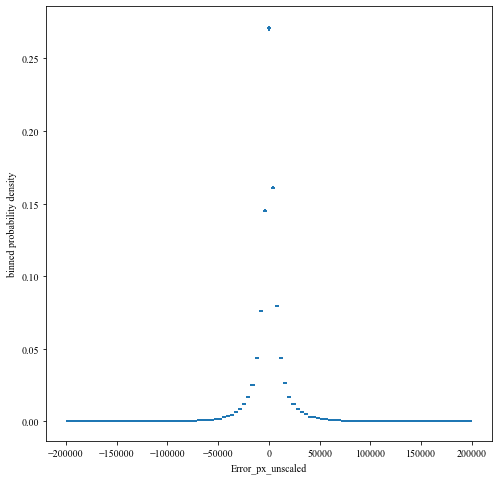

In [318]:
print(np.mean(Error_px_unscaled))
print(np.std(Error_px_unscaled))
binneddensity(Error_px_unscaled, fixedbinning(-200000,200000,100),xlabel = "Error_px_unscaled")

0.03571021550766003
0.9745083426224243


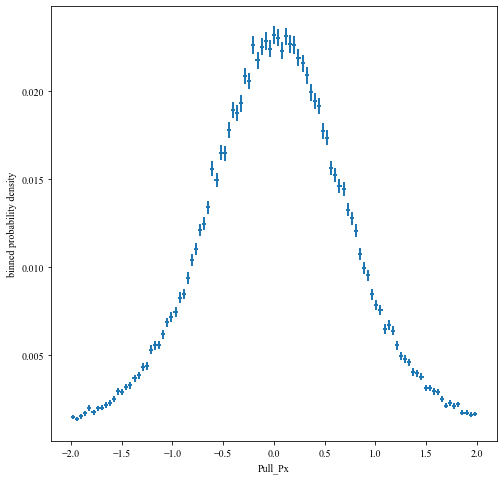

In [319]:
print(np.mean(Pull_px))
print(np.std(Pull_px))
binneddensity(Pull_px, fixedbinning(-2,2,100),xlabel = "Pull_Px")

687.2301436334773
15877.091690726274


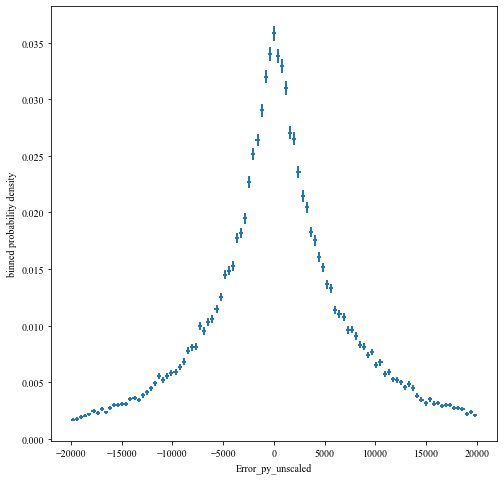

In [320]:
print(np.mean(Error_py_unscaled))
print(np.std(Error_py_unscaled))
binneddensity(Error_py_unscaled, fixedbinning(-20000,20000,100),xlabel = "Error_py_unscaled")

0.043445307220393255
0.9744162050804608


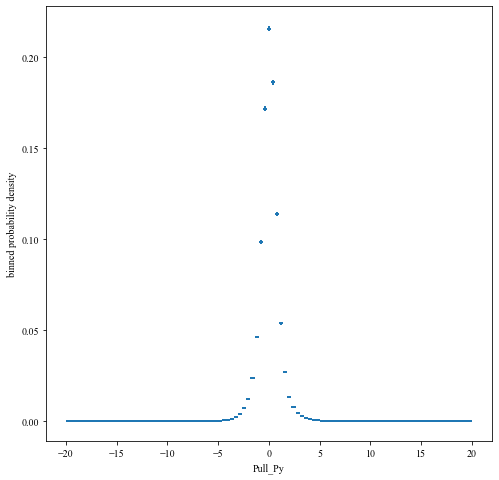

In [321]:
print(np.mean(Pull_py))
print(np.std(Pull_py))
binneddensity(Pull_py, fixedbinning(-20,20,100),xlabel = "Pull_Py")

-273.0503134831692
49755.17258630941


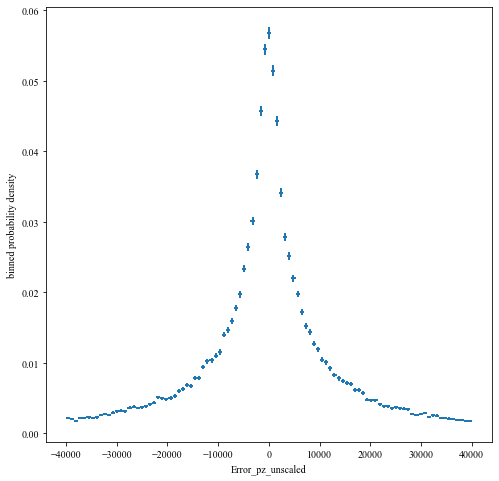

In [322]:
print(np.mean(Error_pz_unscaled))
print(np.std(Error_pz_unscaled))
binneddensity(Error_pz_unscaled, fixedbinning(-40000,40000,100),xlabel = "Error_pz_unscaled")

-0.02241639587314743
0.9933109222283919


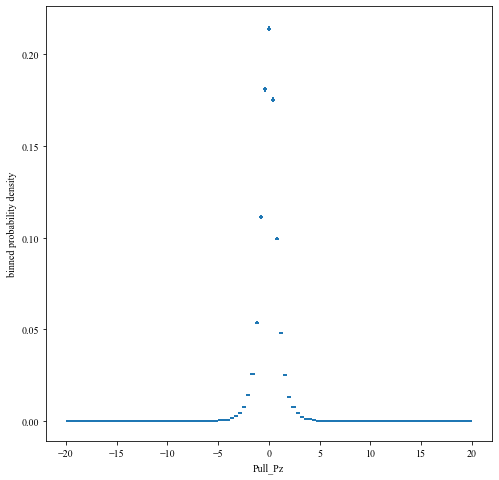

In [323]:
print(np.mean(Pull_pz))
print(np.std(Pull_pz))
binneddensity(Pull_pz, fixedbinning(-20,20,100),xlabel = "Pull_Pz")

-0.00832165415491773
0.18089888824122802


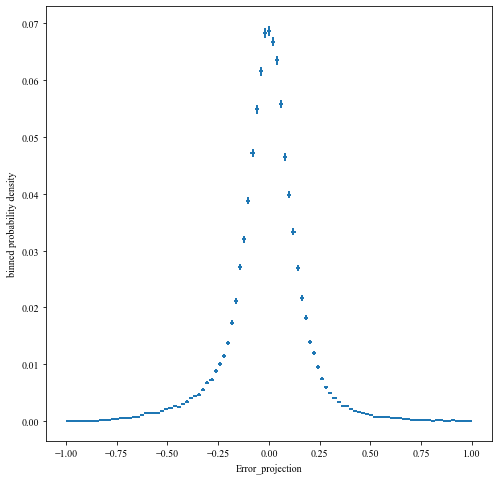

In [324]:
print(np.mean(Error_projection_unscaled))
print(np.std(Error_projection_unscaled))
binneddensity(Error_projection_unscaled, fixedbinning(-1,1,100),xlabel = "Error_projection")

-0.0509600894052888
0.9752369185704013


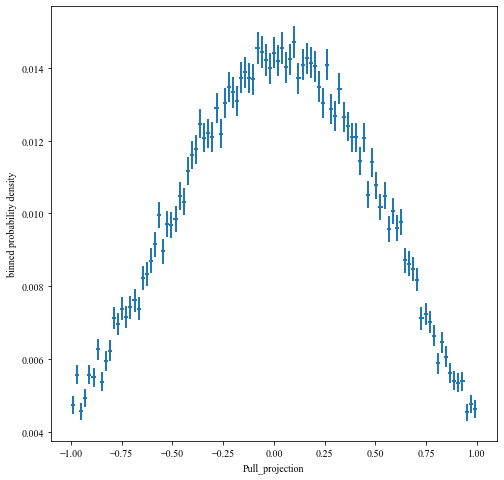

In [325]:
print(np.mean(Pull_projection))
print(np.std(Pull_projection))
binneddensity(Pull_projection, fixedbinning(-2,2,100),xlabel = "Pull_projection")

-0.07230253973435727
14.831595605332765


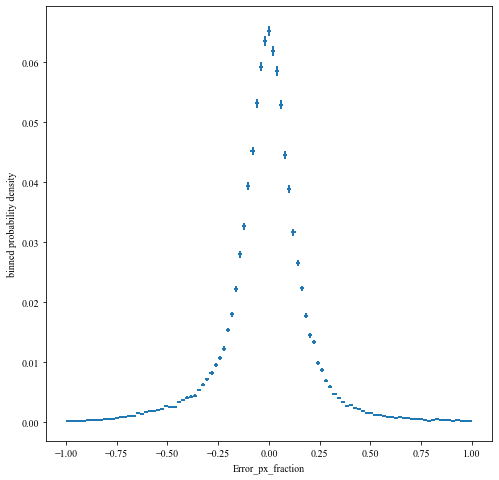

In [326]:
print(np.mean(Error_pxfraction_unscaled))
print(np.std(Error_pxfraction_unscaled))
binneddensity(Error_pxfraction_unscaled, fixedbinning(-1,1,100),xlabel = "Error_px_fraction")

-0.0048749970974901816
1.000019996431569


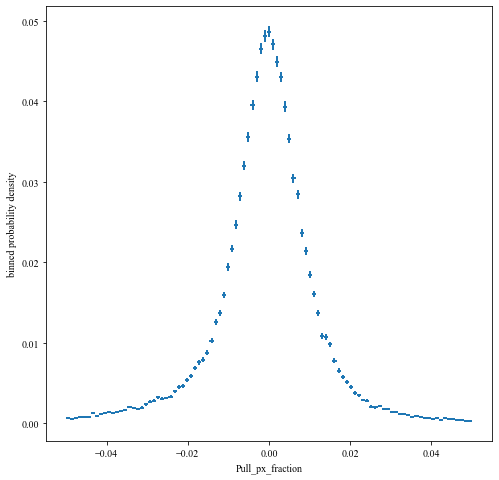

In [327]:
print(np.mean(Pull_pxfraction_unscaled))
print(np.std(Pull_pxfraction_unscaled))
binneddensity(Pull_pxfraction_unscaled, fixedbinning(-0.05,0.05,100),xlabel = "Pull_px_fraction")

-0.3655879607274479
110.86780043820748


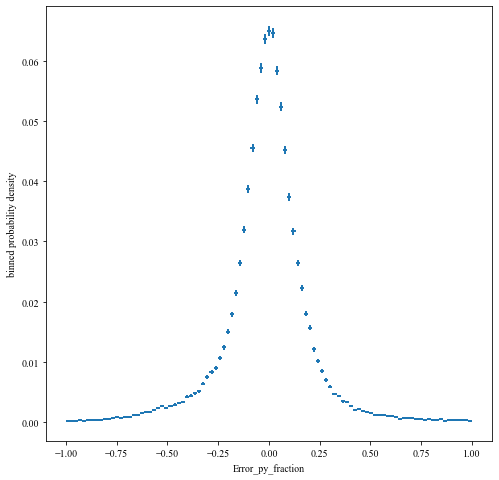

In [328]:
print(np.mean(Error_pyfraction_unscaled))
print(np.std(Error_pyfraction_unscaled))
binneddensity(Error_pyfraction_unscaled, fixedbinning(-1,1,100),xlabel = "Error_py_fraction")

-0.0032975115864687455
0.9999997149354867


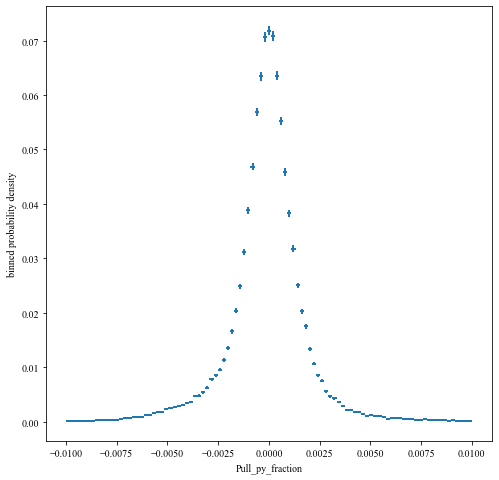

In [329]:
print(np.mean(Pull_pyfraction_unscaled))
print(np.std(Pull_pyfraction_unscaled))
binneddensity(Pull_pyfraction_unscaled, fixedbinning(-0.01,0.01,100),xlabel = "Pull_py_fraction")

-0.01384086044586901
3.03471807052027


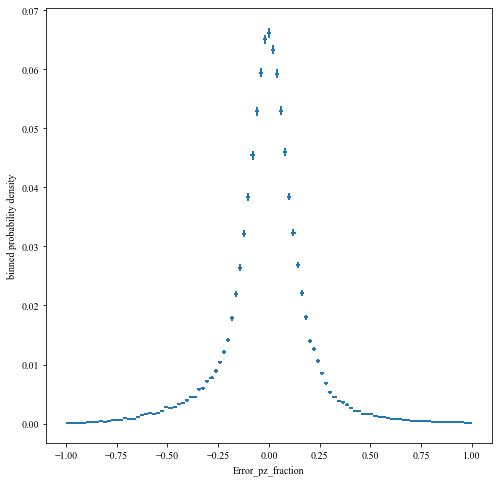

In [330]:
print(np.mean(Error_pzfraction_unscaled))
print(np.std(Error_pzfraction_unscaled))
binneddensity(Error_pzfraction_unscaled, fixedbinning(-1,1,100),xlabel = "Error_pz_fraction")

-0.004553623757484274
0.9984180071198095


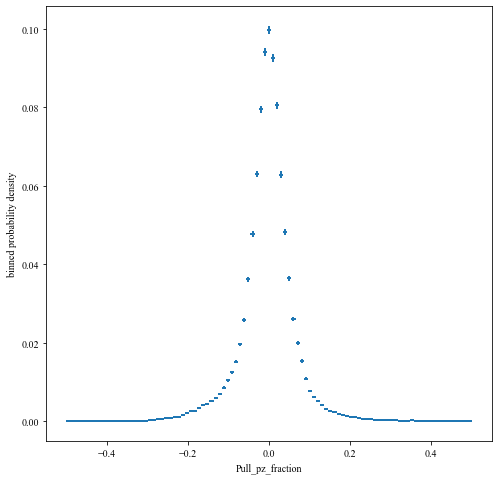

In [331]:
print(np.mean(Pull_pzfraction_unscaled))
print(np.std(Pull_pzfraction_unscaled))
binneddensity(Pull_pzfraction_unscaled, fixedbinning(-0.5,0.5,100),xlabel = "Pull_pz_fraction")

-81.15060812396236
52657.13008068889


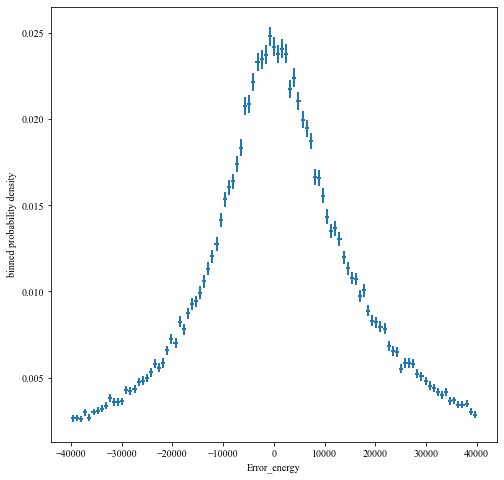

In [332]:
print(np.mean(Error_energy_unscaled))
print(np.std(Error_energy_unscaled))
binneddensity(Error_energy_unscaled, fixedbinning(-40000,40000,100),xlabel = "Error_energy")

-0.0005452045575558248
0.353773162906518


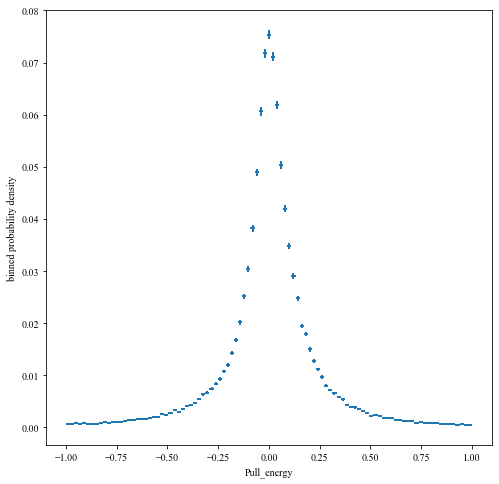

In [333]:
print(np.mean(Pull_energy_unscaled))
print(np.std(Pull_energy_unscaled))
binneddensity(Pull_energy_unscaled, fixedbinning(-1,1,100),xlabel = "Pull_energy")

-738.7913175687688
22102.054257625776


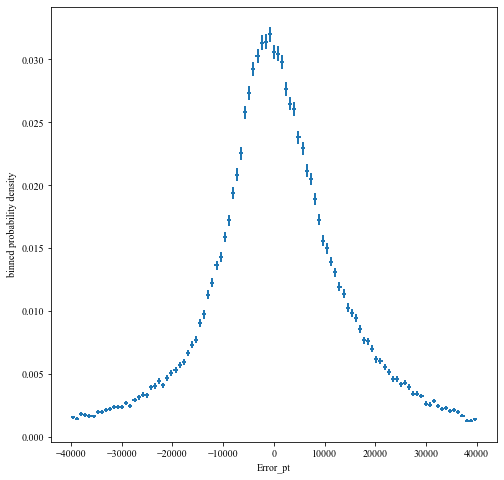

In [334]:
print(np.mean(Error_pt_unscaled))
print(np.std(Error_pt_unscaled))
binneddensity(Error_pt_unscaled, fixedbinning(-40000,40000,100),xlabel = "Error_pt")

-0.03887762537437791
0.9774459244050145


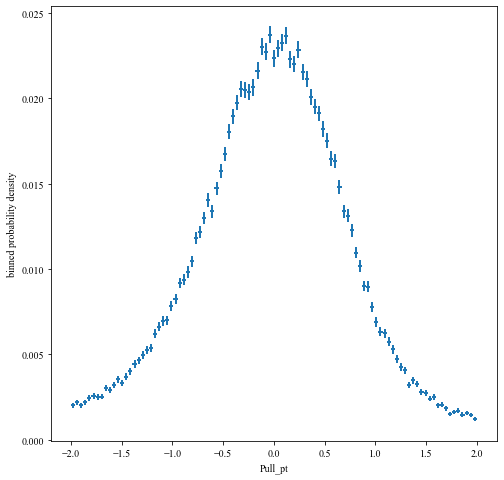

In [336]:
print(np.mean(Pull_pt))
print(np.std(Pull_pt))
binneddensity(Pull_pt, fixedbinning(-2,2,100),xlabel = "Pull_pt")

0.004940527685762069
0.06117590093257988


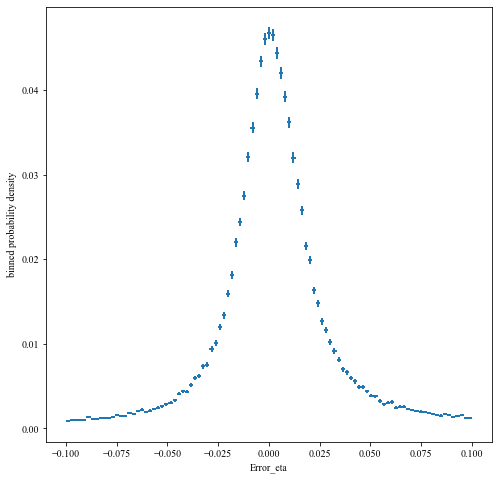

In [61]:
print(np.mean(Error_eta_unscaled))
print(np.std(Error_eta_unscaled))
binneddensity(Error_eta_unscaled, fixedbinning(-0.1,0.1,100),xlabel = "Error_eta")

0.41277721839589326
109.65345671547936


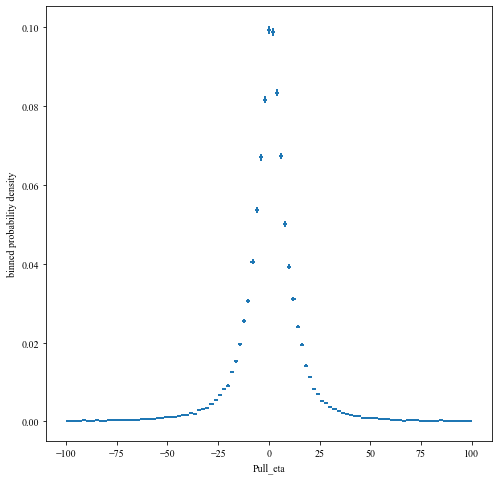

In [70]:
print(np.mean(Pull_eta))
print(np.std(Pull_eta))
binneddensity(Pull_eta, fixedbinning(-100,100,100),xlabel = "Pull_eta")

0.0009553637788360243
0.37411893152644776


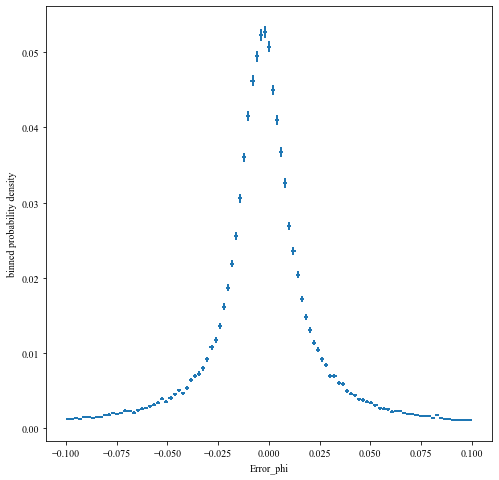

In [63]:
print(np.mean(Error_phi_unscaled))
print(np.std(Error_phi_unscaled))
binneddensity(Error_phi_unscaled, fixedbinning(-0.1,0.1,100),xlabel = "Error_phi")

-0.33474341975709754
6.18715776768199


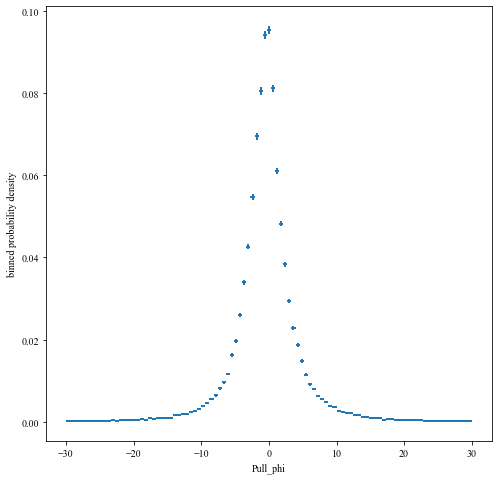

In [71]:
print(np.mean(Pull_phi))
print(np.std(Pull_phi))
binneddensity(Pull_phi, fixedbinning(-30,30,100),xlabel = "Pull_phi")

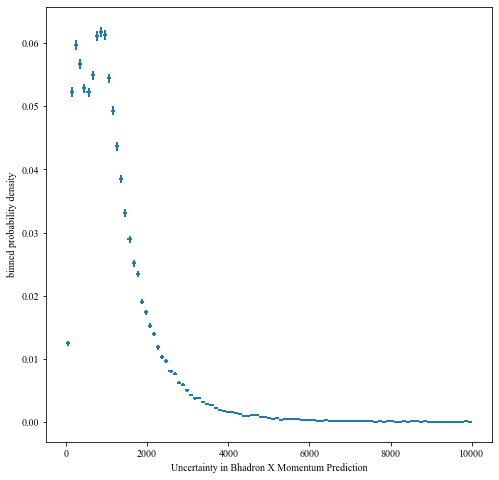

In [104]:
binneddensity(Predictions_Uncertainty[:,0], fixedbinning(0,1e4,100), xlabel = "Uncertainty in Bhadron X Momentum Prediction")

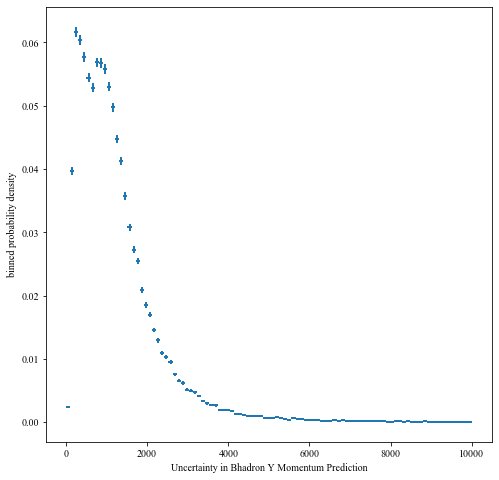

In [105]:
binneddensity(Predictions_Uncertainty[:,1], fixedbinning(0,1e4,100), xlabel = "Uncertainty in Bhadron Y Momentum Prediction")

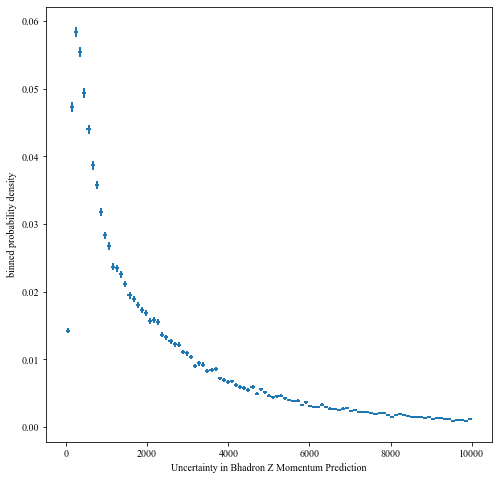

In [106]:
binneddensity(Predictions_Uncertainty[:,2], fixedbinning(0,1e4,100), xlabel = "Uncertainty in Bhadron Z Momentum Prediction")

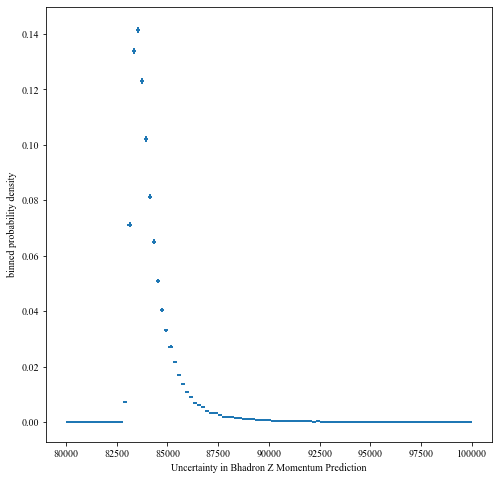

In [111]:
binneddensity(Predictions_Uncertainty[:,3], fixedbinning(8e4,1e5,100), xlabel = "Uncertainty in Bhadron pt Momentum Prediction")

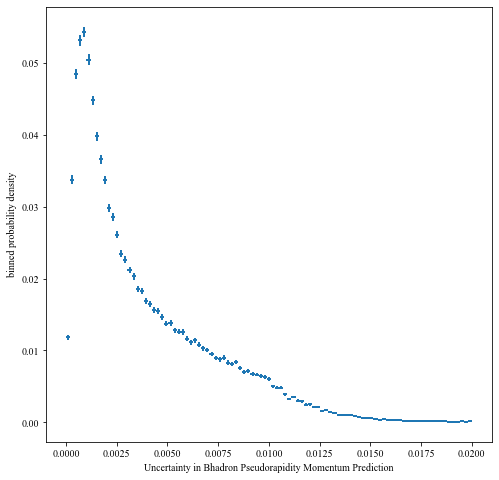

In [126]:
binneddensity(Predictions_Uncertainty[:,4], fixedbinning(0,0.02,100), xlabel = "Uncertainty in Bhadron Pseudorapidity Momentum Prediction")

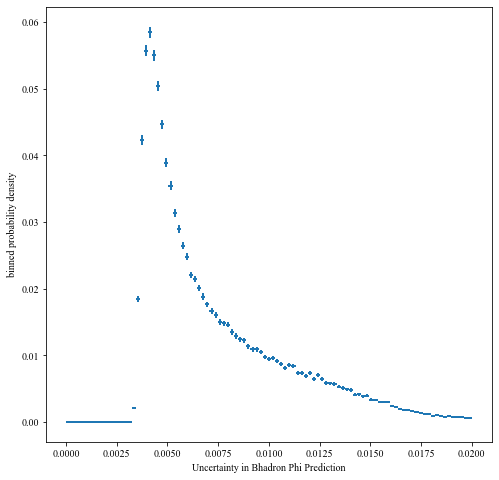

In [125]:
binneddensity(Predictions_Uncertainty[:,5], fixedbinning(0,0.02,100), xlabel = "Uncertainty in Bhadron Phi Prediction")

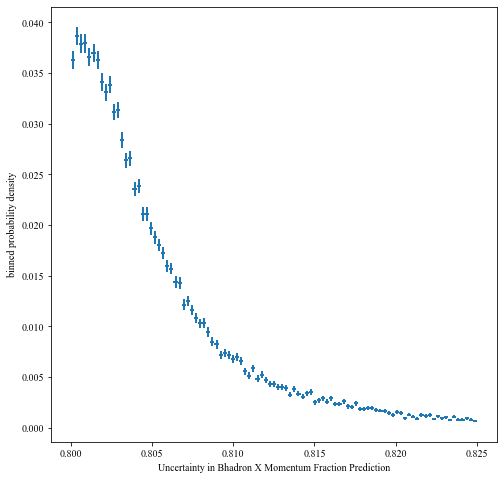

In [127]:
binneddensity(Predictions_Uncertainty[:,6], fixedbinning(0.8,0.825,100), xlabel = "Uncertainty in Bhadron X Momentum Fraction Prediction")

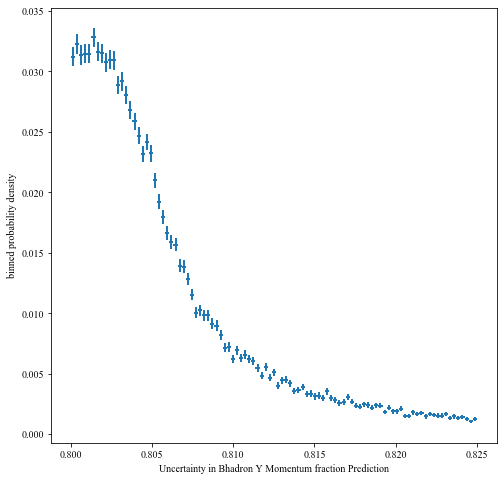

In [128]:
binneddensity(Predictions_Uncertainty[:,7], fixedbinning(0.8,0.825,100), xlabel = "Uncertainty in Bhadron Y Momentum fraction Prediction")

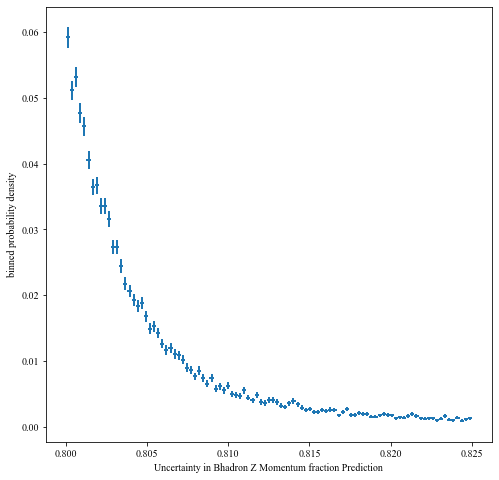

In [129]:
binneddensity(Predictions_Uncertainty[:,8], fixedbinning(0.8,0.825,100), xlabel = "Uncertainty in Bhadron Z Momentum fraction Prediction")

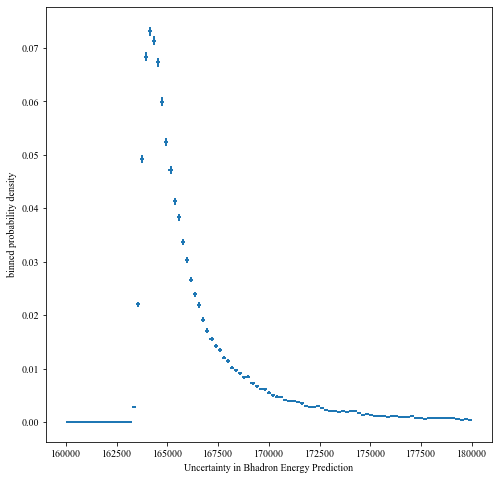

In [136]:
binneddensity(Predictions_Uncertainty[:,9], fixedbinning(1.6e5,1.8e5,100), xlabel = "Uncertainty in Bhadron Energy Prediction")

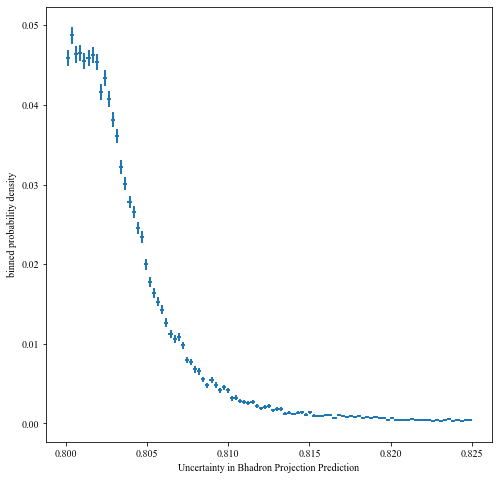

In [140]:
binneddensity(Predictions_Uncertainty[:,12], fixedbinning(0.8,0.825,100), xlabel = "Uncertainty in Bhadron Projection Prediction")

In [428]:
Multivariate_Gaussian_Negative_Likelihood_Loss_Curve(bhads_targets_clean, Predictions)

ValueError: in user code:

    File "/home/physics/phujdj/DeepLearningParticlePhysics/HffragDeepSetsProjection.py", line 102, in None  *
        lambda x: generate_triu(x, n_targets)
    File "/home/physics/phujdj/DeepLearningParticlePhysics/HffragDeepSetsProjection.py", line 89, in generate_triu  *
        covariances = tf.sparse.SparseTensor(indices, covariances, dense_shape = tf.cast((n_targets,n_targets), dtype = tf.int64))

    ValueError: Shape (96631, 104) must have rank 1


In [346]:
mu = Predictions_X[:,:2]
cov = covariances[:,:2, :2]

In [347]:
print(mu.shape, cov.shape)

(96657, 2) (96657, 2, 2)


In [417]:
print(mu[2])
print(cov[2])

[45929.81900221  1823.62223486]
[[16403.34454924  8149.94002691]
 [ 8149.94002691  3947.47359048]]


In [376]:
np.shape(cov)[1:]

(2, 2)

In [388]:
iu1 = np.triu_indices(2)
print(iu1)
elements = cov[0][iu1]
print(elements)

(array([0, 0, 1]), array([0, 1, 1]))
[  8985.69441433 -35349.41402499  10392.18216356]


In [394]:
# Generates an upper triangular matrix from the variances and covariances of the predictions
def generate_triu(mean_covariance_matrix, n_targets):
    variances = mean_covariance_matrix[n_targets:2*n_targets]
    covariances = mean_covariance_matrix[2*n_targets:]

    ones = tf.ones((n_targets,n_targets), dtype = tf.float32)
    mask_a = tf.linalg.band_part(ones, 0, -1)
    mask_b = tf.linalg.band_part(ones, 0, 0)
    mask = tf.subtract(mask_a,mask_b)
    zero = tf.constant(0, dtype = tf.float32)
    non_zero = tf.not_equal(mask,zero)
    indices = tf.where(non_zero)
    covariances = tf.sparse.SparseTensor(indices, covariances, dense_shape = tf.cast((n_targets,n_targets), dtype = tf.int64))
    covariances = tf.sparse.to_dense(covariances)
    variances = tf.linalg.diag(variances)
    uncertainties = variances + covariances

    return uncertainties

In [402]:
means_matrix_covariance = np.append(mu[0], elements)
print(mu[0].shape)
print(elements.shape)
print(means_matrix_covariance.shape)

(2,)
(3,)
(5,)


In [397]:
from scipy.stats import multivariate_normal
random_seed = 42
distr = multivariate_normal(cov = cov[0], mean = mu[0],
                                seed = random_seed)

ValueError: the input matrix must be positive semidefinite

In [457]:
uncertainties = generate_triu(means_matrix_covariance, 2)
print(uncertainties)
print(means_matrix_covariance.shape)

tf.Tensor(
[[  8985.69441433  10392.18216356]
 [     0.         -35349.41402499]], shape=(2, 2), dtype=float64)
(5,)


In [421]:
uncertainties

<tf.Tensor: shape=(2, 2), dtype=float64, numpy=
array([[  8985.69441433,  10392.18216356],
       [     0.        , -35349.41402499]])>

In [422]:
mvn = tfd.MultivariateNormalTriL(loc = mu[0], scale_tril= uncertainties)

In [418]:
mvn = tfd.MultivariateNormalFullCovariance(
    loc = mu[2],
    covariance_matrix = cov[2]
)

2023-02-22 22:33:00.308355: W tensorflow/core/kernels/linalg/cholesky_op.cc:56] Cholesky decomposition was not successful. Eigen::LLT failed with error code 1. Filling lower-triangular output with NaNs.


In [423]:
mvn.mean()

<tf.Tensor: shape=(2,), dtype=float64, numpy=array([37851.78594106, 41920.39452671])>

In [424]:
mvn.covariance()

<tf.Tensor: shape=(2, 2), dtype=float64, numpy=
array([[8.07427041e+07, 0.00000000e+00],
       [0.00000000e+00, 1.24958107e+09]])>

In [426]:
bhads_targets_clean[0,:2]

masked_array(data=[53148.34789845, 57773.79152088],
             mask=False,
       fill_value=-999.0)

In [427]:
mvn.prob(bhads_targets_clean[0,:2])

<tf.Tensor: shape=(), dtype=float64, numpy=1.0639928278051769e-10>

In [409]:
mvn.mean()

<tf.Tensor: shape=(2,), dtype=float64, numpy=array([37851.78594106, 41920.39452671])>

In [410]:
mvn.covariance()

<tf.Tensor: shape=(2, 2), dtype=float64, numpy=
array([[8.07427041e+07, 0.00000000e+00],
       [0.00000000e+00, 1.24958107e+09]])>

In [354]:
covs = np.triu(cov[0])

In [360]:
from tensorflow_probability import distributions as tfd

In [367]:
mvn = tfd.MultivariateNormalTriL(
    loc = mu[0],
    scale_tril = cov[0]
)

In [365]:
mvn.mean()

<tf.Tensor: shape=(2,), dtype=float64, numpy=array([37851.78594106, 41920.39452671])>

In [ ]:
# Generates an upper triangular matrix from the variances and covariances of the predictions
def generate_triu(mean_covariance_matrix, n_targets):
    variances = mean_covariance_matrix[n_targets:2*n_targets]
    covariances = mean_covariance_matrix[2*n_targets:]

    ones = tf.ones((n_targets,n_targets), dtype = tf.float32)
    mask_a = tf.linalg.band_part(ones, 0, -1)
    mask_b = tf.linalg.band_part(ones, 0, 0)
    mask = tf.subtract(mask_a,mask_b)
    zero = tf.constant(0, dtype = tf.float32)
    non_zero = tf.not_equal(mask,zero)
    indices = tf.where(non_zero)
    covariances = tf.sparse.SparseTensor(indices, covariances, dense_shape = tf.cast((n_targets,n_targets), dtype = tf.int64))
    covariances = tf.sparse.to_dense(covariances)
    variances = tf.linalg.diag(variances)
    uncertainties = variances + covariances

    return uncertainties

In [368]:
mvn.covariance()

<tf.Tensor: shape=(2, 2), dtype=float64, numpy=
array([[ 8.07427041e+07, -3.17639032e+08],
       [-3.17639032e+08,  1.35757852e+09]])>

In [ ]:
mvn.covari

In [356]:
scale = tf.linalg.cholesky(cov)

2023-02-22 21:57:01.550737: W tensorflow/core/kernels/linalg/cholesky_op.cc:56] Cholesky decomposition was not successful. Eigen::LLT failed with error code 1. Filling lower-triangular output with NaNs.
2023-02-22 21:57:01.550769: W tensorflow/core/kernels/linalg/cholesky_op.cc:56] Cholesky decomposition was not successful. Eigen::LLT failed with error code 1. Filling lower-triangular output with NaNs.
2023-02-22 21:57:01.550800: W tensorflow/core/kernels/linalg/cholesky_op.cc:56] Cholesky decomposition was not successful. Eigen::LLT failed with error code 1. Filling lower-triangular output with NaNs.
2023-02-22 21:57:01.550807: W tensorflow/core/kernels/linalg/cholesky_op.cc:56] Cholesky decomposition was not successful. Eigen::LLT failed with error code 1. Filling lower-triangular output with NaNs.
2023-02-22 21:57:01.550811: W tensorflow/core/kernels/linalg/cholesky_op.cc:56] Cholesky decomposition was not successful. Eigen::LLT failed with error code 1. Filling lower-triangular out

In [438]:
Multivariate_Gaussian_Negative_Likelihood_Loss_Curve(Standardized_Bhads_targets, predictions)

<tf.Tensor: shape=(96657,), dtype=float32, numpy=
array([  2.96142  , -11.6408415,   2.4079819, ..., -10.048252 ,
         2.2169762,  -3.9018755], dtype=float32)>

In [439]:
# Takes the means, variances and covariances predicted by the network and computs the multivariate negative likelihood loss
def Multivariate_Gaussian_Distribution(true,mean_covariance_matrix):
    
    n_targets =  np.shape(true)[1]
    means = mean_covariance_matrix[:,:n_targets]
    uncertainties = tf.map_fn(lambda x: generate_triu(x, n_targets), mean_covariance_matrix, dtype = tf.float32)
    mvn = tfd.MultivariateNormalTriL(loc = means, scale_tril = uncertainties)
    return mvn

In [455]:
print(Standardized_Bhads_targets[:,:2].shape)
n_targets = 2
print(predictions[:,:2].shape)
choice = n_targets + n_targets*(n_targets+1)/2
choice

(96657, 2)
(96657, 2)


3.0

In [453]:
predictions[:,:3].shape

(96657, 3)

In [458]:
mvn = Multivariate_Gaussian_Distribution(Standardized_Bhads_targets[:,:2],predictions[:,:5])
mvn

<tfp.distributions.MultivariateNormalTriL 'MultivariateNormalTriL' batch_shape=[96657] event_shape=[2] dtype=float32>

In [502]:
distr = mvn.sample(5000)

(-2.6444363236427306,
 3.7356512188911437,
 -4.048851549625397,
 3.7261016964912415)

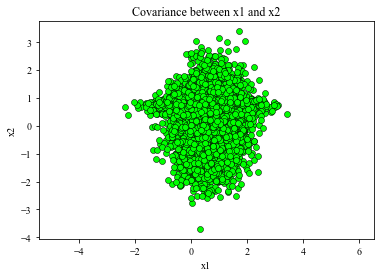

In [504]:
# Plotting the generated samples
plt.plot(distr[:,0],distr[:,2], 'o', c='lime',
    markeredgewidth = 0.5,
    markeredgecolor = 'black')
plt.title(f'Covariance between x1 and x2')
plt.xlabel('x1')
plt.ylabel('x2')
plt.axis('equal')

In [472]:
mean_1, mean_2 = mvn.mean()[:,0], mvn.mean()[:,1]
std_1, std_2 = mvn.covariance()[:,0], mvn.covariance()[:,1]

In [478]:
std_1[0][0]
std_2[0][1]

<tf.Tensor: shape=(), dtype=float32, numpy=0.34818178>

In [516]:
x, y = np.linspace(-1.0, 2.5,num =100), np.linspace(-2.0, 2.0, num = 100)
X,Y = np.meshgrid(x,y)
print(X.shape,Y.shape)

(100, 100) (100, 100)


In [484]:
X[0,0]

-1.8237944841384888

In [517]:
# Generating the density function
    # for each point in the meshgrid
pdf = np.zeros(X.shape)
print(pdf.shape)
for i in range(X.shape[0]):
    for j in range(X.shape[1]):
        pdf[i,j] = mvn.prob([X[i,j], Y[i,j]])[0]

(100, 100)


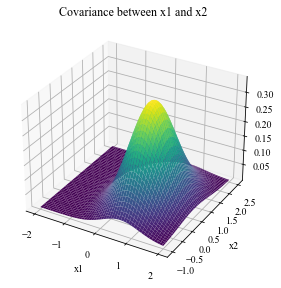

In [518]:
fig = plt.figure()
ax = fig.add_subplot(projection = '3d')
ax.plot_surface(Y, X, pdf, cmap = 'viridis')
plt.xlabel("x1")
plt.ylabel("x2")
plt.title(f'Covariance between x1 and x2')
plt.tight_layout()
plt.show()

In [519]:
#Import the relevant modules
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import scipy
import plotly.graph_objects as go
%matplotlib inline
#Plots the 3d gaussian negative likelihood loss function surface vs 
#the error (pred-true) and predicted uncertainty
fig = go.Figure(data = [go.Surface(z = pdf, x = X, y = Y)])
fig.update_layout(title = "LogNormal Loss Function", scene = dict(xaxis_title = "Absolute_Errors",yaxis_title = "Uncertainty", zaxis_title = "Loss"), autosize = False,
width = 500, height = 500)
fig.update_traces(contours_z = dict(show = True, usecolormap = True, highlightcolor = "limegreen", project_z = True))
fig.update_scenes(camera_eye_x = 1.5, camera_eye_y = -2.5, camera_eye_z = 0.5)

Text(0.5, 0.92, 'Covariance between x1 and x2')

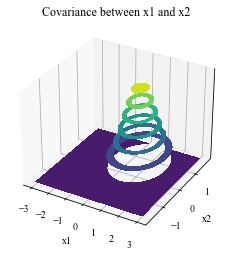

In [498]:
fig = plt.figure()
ax2 = fig.add_subplot(projection = '3d')
ax2.axes.zaxis.set_ticks([])
plt.contourf(X, Y, pdf, cmap='viridis')
plt.xlabel("x1")
plt.ylabel("x2")
plt.title(f'Covariance between x1 and x2')

In [436]:
covariance_matrices_true[0]

array([[[ 0.13729511, -0.54073644,  0.2798087 , ...,  0.11273433,
         -0.73864609,  0.43583056],
        [-0.54073644,  0.15915129, -0.99136889, ..., -1.64173663,
         -0.47843948,  0.63447118],
        [ 0.2798087 , -0.99136889,  0.19423735, ...,  1.03839338,
          1.86037266,  0.93927073],
        ...,
        [ 0.11273433, -1.64173663,  1.03839338, ...,  0.33002904,
          1.12518728,  0.32827771],
        [-0.73864609, -0.47843948,  1.86037266, ...,  1.12518728,
          0.294366  ,  0.17845635],
        [ 0.43583056,  0.63447118,  0.93927073, ...,  0.32827771,
          0.17845635,  0.74457181]],

       [[ 0.04127257, -0.77821034,  0.45005518, ...,  0.29440206,
         -0.62730867,  0.2517482 ],
        [-0.77821034,  0.14726642, -0.76363027, ..., -1.34922004,
         -0.41145381,  0.57977945],
        [ 0.45005518, -0.76363027,  0.12867974, ...,  0.64635903,
          2.22716498,  0.75120974],
        ...,
        [ 0.29440206, -1.34922004,  0.64635903, ...,  

In [ ]:
means = Predictions[:,:13]
mvn = tfd.

/home/physics/phujdj/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0, 0.5, 'The predicted X momenta of b hadron jets')

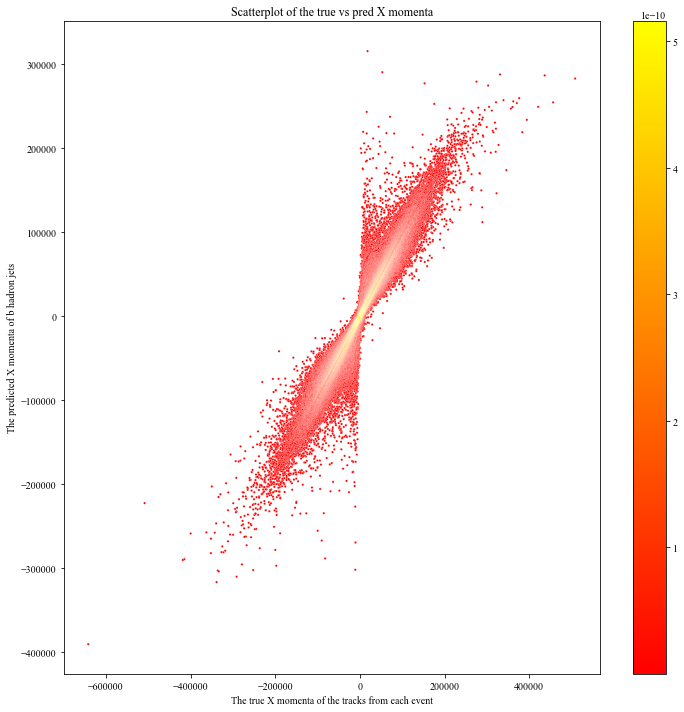

In [63]:
import matplotlib as mpl
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
fig, ax = plt.subplots(figsize = (12,12))
x = bhads_targets_clean[:,0]
y = Predictions_X[:,0]
grid = np.vstack([x, y])
z = gaussian_kde(grid)(grid)
idx = z.argsort()
x,y,z = x[idx], y[idx], z[idx]

im = sns.scatterplot(
    x,
    y,
    c = z,
    s = 5,
    cmap = "autumn",
    )
norm = plt.Normalize(z.min(), z.max())
sm = plt.cm.ScalarMappable(cmap = "autumn", norm = norm)
sm.set_array([])
im.figure.colorbar(sm)
ax.set_title("Scatterplot of the true vs pred X momenta")
ax.set_xlabel("The true X momenta of the tracks from each event")
ax.set_ylabel("The predicted X momenta of b hadron jets")

/home/physics/phujdj/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0, 0.5, 'The predicted Y momenta of b hadron jets')

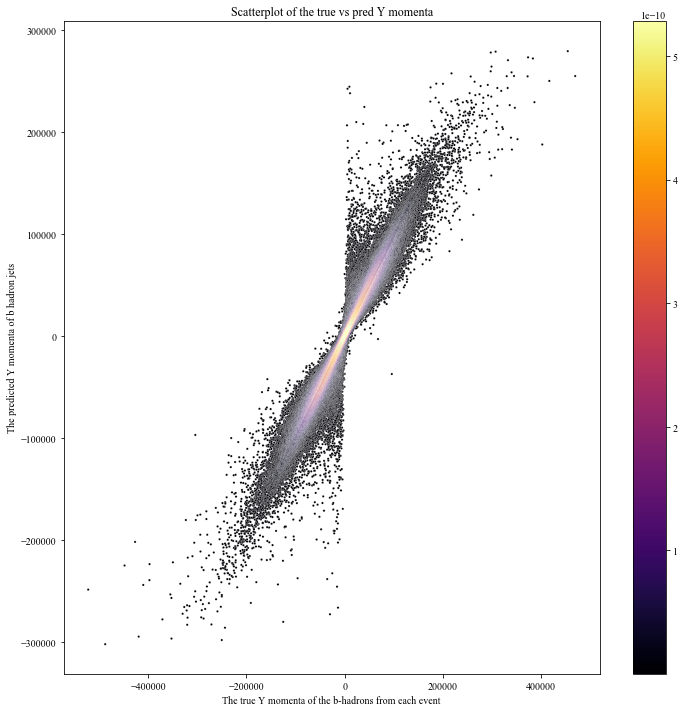

In [64]:
import matplotlib as mpl
from scipy.stats import gaussian_kde
fig, ax = plt.subplots(figsize = (12,12))
x = bhads_targets_clean[:,1]
y = Predictions_X[:,1]
grid = np.vstack([x, y])
z = gaussian_kde(grid)(grid)
idx = z.argsort()
x,y,z = x[idx], y[idx], z[idx]

im = sns.scatterplot(
    x,
    y,
    c = z,
    s = 5,
    cmap = "inferno",
    )
norm = plt.Normalize(z.min(), z.max())
sm = plt.cm.ScalarMappable(cmap = "inferno", norm = norm)
sm.set_array([])
im.figure.colorbar(sm)
ax.set_title("Scatterplot of the true vs pred Y momenta")
ax.set_xlabel("The true Y momenta of the b-hadrons from each event")
ax.set_ylabel("The predicted Y momenta of b hadron jets")

/home/physics/phujdj/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0, 0.5, 'The predicted Z momenta of b hadron jets')

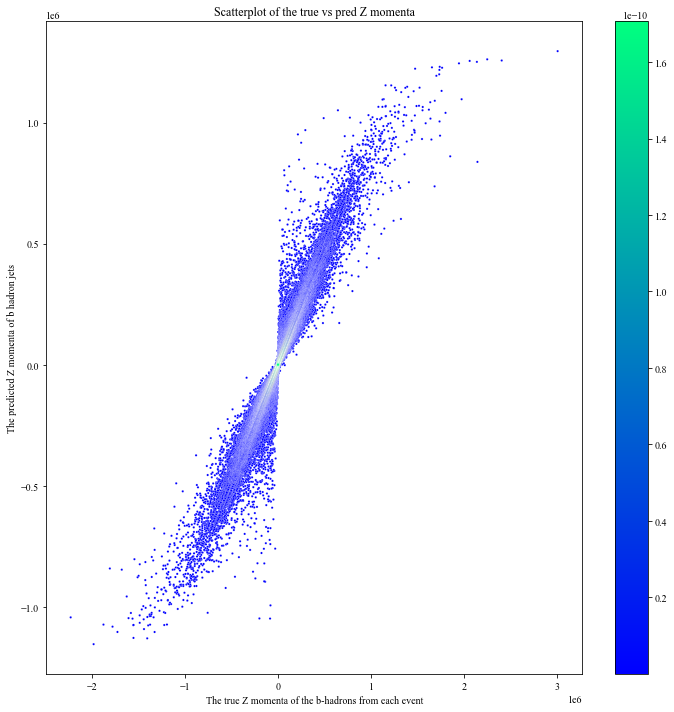

In [65]:
import matplotlib as mpl
from scipy.stats import gaussian_kde
fig, ax = plt.subplots(figsize = (12,12))
x = bhads_targets_clean[:,2]
y = Predictions_X[:,2]
grid = np.vstack([x, y])
z = gaussian_kde(grid)(grid)
idx = z.argsort()
x,y,z = x[idx], y[idx], z[idx]

im = sns.scatterplot(
    x,
    y,
    c = z,
    s = 5,
    cmap = "winter",
    )
norm = plt.Normalize(z.min(), z.max())
sm = plt.cm.ScalarMappable(cmap = "winter", norm = norm)
sm.set_array([])
im.figure.colorbar(sm)
ax.set_title("Scatterplot of the true vs pred Z momenta")
ax.set_xlabel("The true Z momenta of the b-hadrons from each event")
ax.set_ylabel("The predicted Z momenta of b hadron jets")

/home/physics/phujdj/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0, 0.5, 'The predicted transverse momenta of b hadron jets')

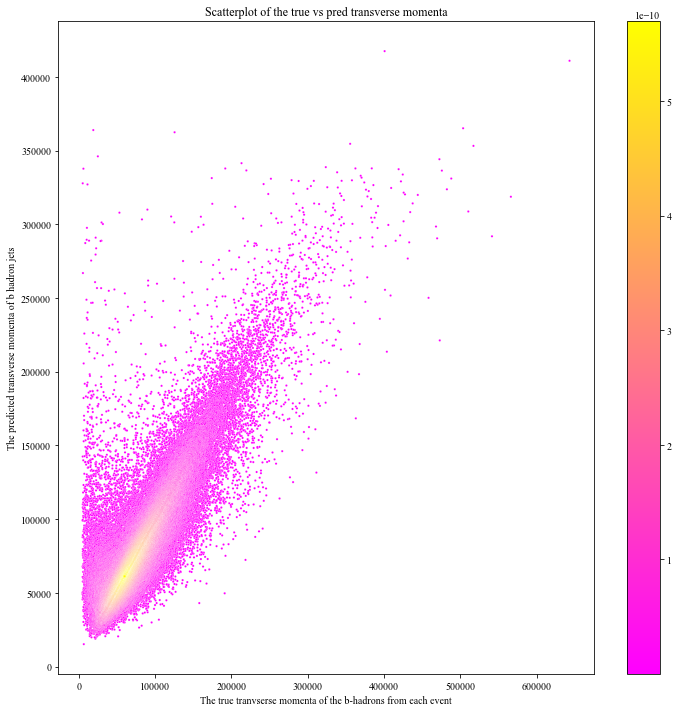

In [66]:
import matplotlib as mpl
from scipy.stats import gaussian_kde
fig, ax = plt.subplots(figsize = (12,12))
x = bhads_targets_clean[:,3]
y = Predictions_X[:,3]
grid = np.vstack([x, y])
z = gaussian_kde(grid)(grid)
idx = z.argsort()
x,y,z = x[idx], y[idx], z[idx]

im = sns.scatterplot(
    x,
    y,
    c = z,
    s = 5,
    cmap = "spring",
    )
norm = plt.Normalize(z.min(), z.max())
sm = plt.cm.ScalarMappable(cmap = "spring", norm = norm)
sm.set_array([])
im.figure.colorbar(sm)
ax.set_title("Scatterplot of the true vs pred transverse momenta")
ax.set_xlabel("The true tranvserse momenta of the b-hadrons from each event")
ax.set_ylabel("The predicted transverse momenta of b hadron jets")

/home/physics/phujdj/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0, 0.5, 'The predicted pseudorapidity of b hadron jets')

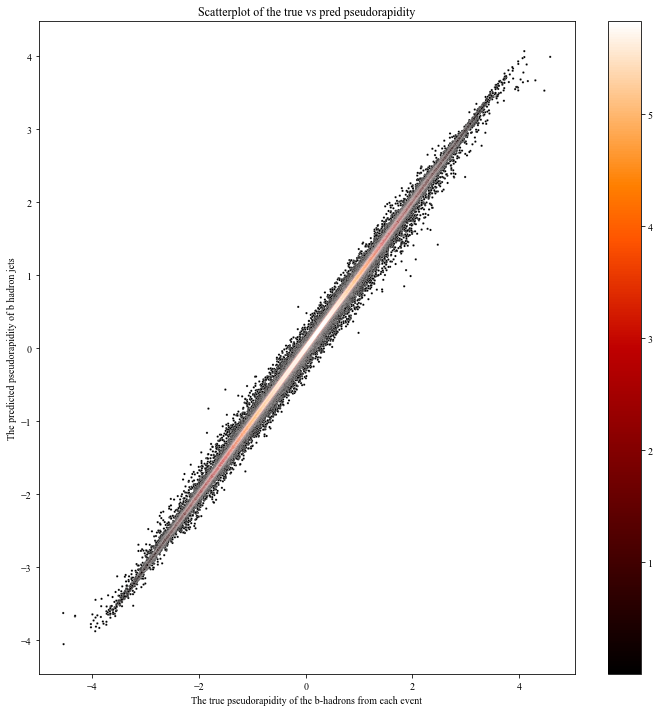

In [67]:
import matplotlib as mpl
from scipy.stats import gaussian_kde
fig, ax = plt.subplots(figsize = (12,12))
x = bhads_targets_clean[:,4]
y = Predictions_X[:,4]
grid = np.vstack([x, y])
z = gaussian_kde(grid)(grid)
idx = z.argsort()
x,y,z = x[idx], y[idx], z[idx]

im = sns.scatterplot(
    x,
    y,
    c = z,
    s = 5,
    cmap = "gist_heat",
    )
norm = plt.Normalize(z.min(), z.max())
sm = plt.cm.ScalarMappable(cmap = "gist_heat", norm = norm)
sm.set_array([])
im.figure.colorbar(sm)
ax.set_title("Scatterplot of the true vs pred pseudorapidity")
ax.set_xlabel("The true pseudorapidity of the b-hadrons from each event")
ax.set_ylabel("The predicted pseudorapidity of b hadron jets")

/home/physics/phujdj/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0, 0.5, 'The predicted phi of b hadron jets')

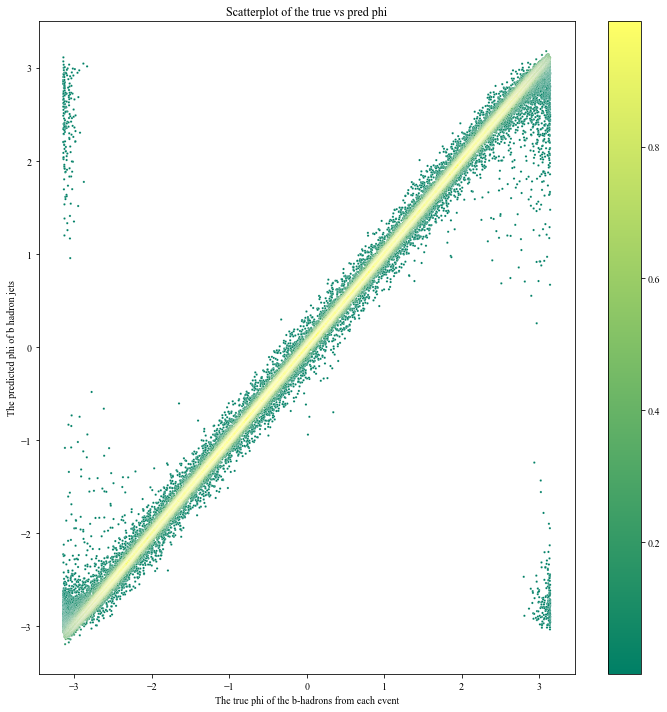

In [68]:
import matplotlib as mpl
from scipy.stats import gaussian_kde
fig, ax = plt.subplots(figsize = (12,12))
x = bhads_targets_clean[:,5]
y = Predictions_X[:,5]
grid = np.vstack([x, y])
z = gaussian_kde(grid)(grid)
idx = z.argsort()
x,y,z = x[idx], y[idx], z[idx]

im = sns.scatterplot(
    x,
    y,
    c = z,
    s = 5,
    cmap = "summer",
    )
norm = plt.Normalize(z.min(), z.max())
sm = plt.cm.ScalarMappable(cmap = "summer", norm = norm)
sm.set_array([])
im.figure.colorbar(sm)
ax.set_title("Scatterplot of the true vs pred phi")
ax.set_xlabel("The true phi of the b-hadrons from each event")
ax.set_ylabel("The predicted phi of b hadron jets")

/home/physics/phujdj/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0, 0.5, 'The predicted X fraction of b hadron jets')

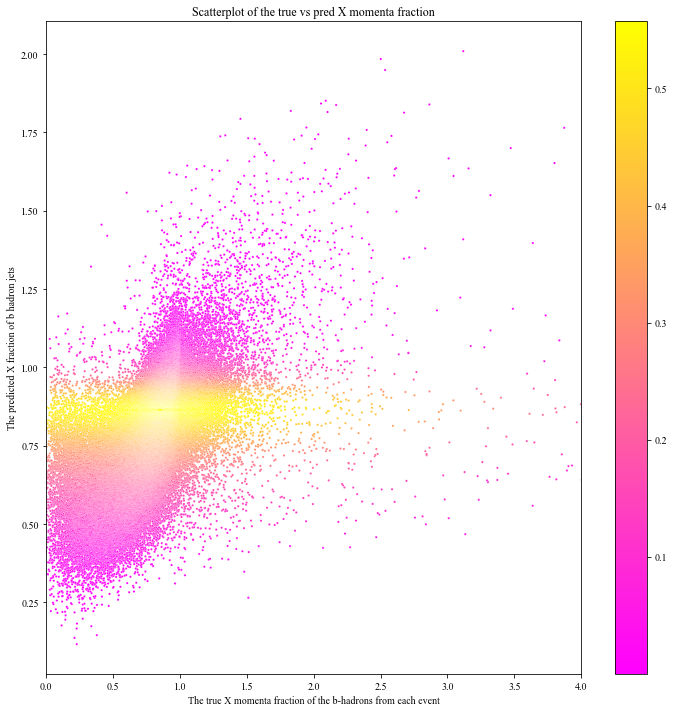

In [69]:
import matplotlib as mpl
from scipy.stats import gaussian_kde
fig, ax = plt.subplots(figsize = (12,12))
x = bhads_targets_clean[:,6]
y = Predictions_X[:,6]
grid = np.vstack([x, y])
z = gaussian_kde(grid)(grid)
idx = z.argsort()
x,y,z = x[idx], y[idx], z[idx]

im = sns.scatterplot(
    x,
    y,
    c = z,
    s = 5,
    cmap = "spring",
    )
norm = plt.Normalize(z.min(), z.max())
sm = plt.cm.ScalarMappable(cmap = "spring", norm = norm)
sm.set_array([])
im.figure.colorbar(sm)
ax.set_xlim([0,4])
ax.set_title("Scatterplot of the true vs pred X momenta fraction")
ax.set_xlabel("The true X momenta fraction of the b-hadrons from each event")
ax.set_ylabel("The predicted X fraction of b hadron jets")

/home/physics/phujdj/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0, 0.5, 'The predicted Y fraction of b hadron jets')

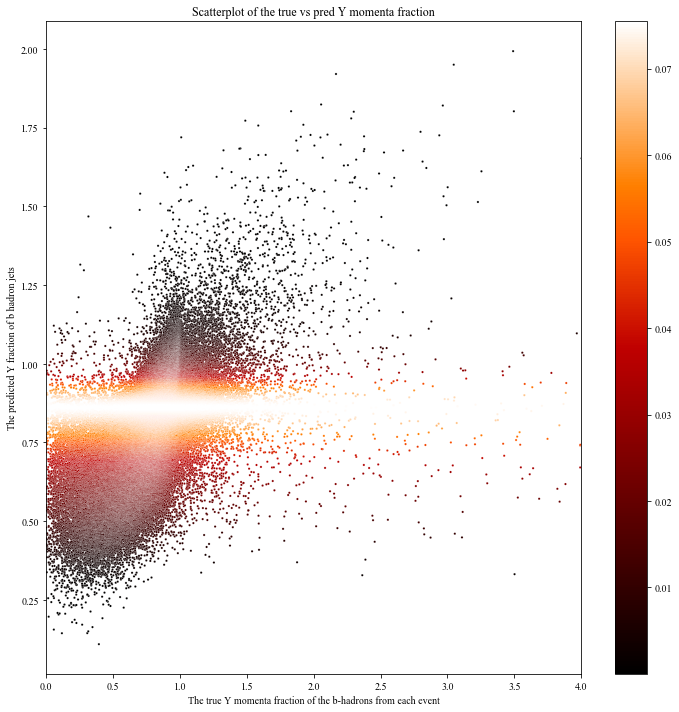

In [70]:
import matplotlib as mpl
from scipy.stats import gaussian_kde
fig, ax = plt.subplots(figsize = (12,12))
x = bhads_targets_clean[:,7]
y = Predictions_X[:,7]
grid = np.vstack([x, y])
z = gaussian_kde(grid)(grid)
idx = z.argsort()
x,y,z = x[idx], y[idx], z[idx]

im = sns.scatterplot(
    x,
    y,
    c = z,
    s = 5,
    cmap = "gist_heat",
    )
norm = plt.Normalize(z.min(), z.max())
sm = plt.cm.ScalarMappable(cmap = "gist_heat", norm = norm)
sm.set_array([])
im.figure.colorbar(sm)
ax.set_xlim([0,4])
ax.set_title("Scatterplot of the true vs pred Y momenta fraction")
ax.set_xlabel("The true Y momenta fraction of the b-hadrons from each event")
ax.set_ylabel("The predicted Y fraction of b hadron jets")

/home/physics/phujdj/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0, 0.5, 'The predicted Z fraction of b hadron jets')

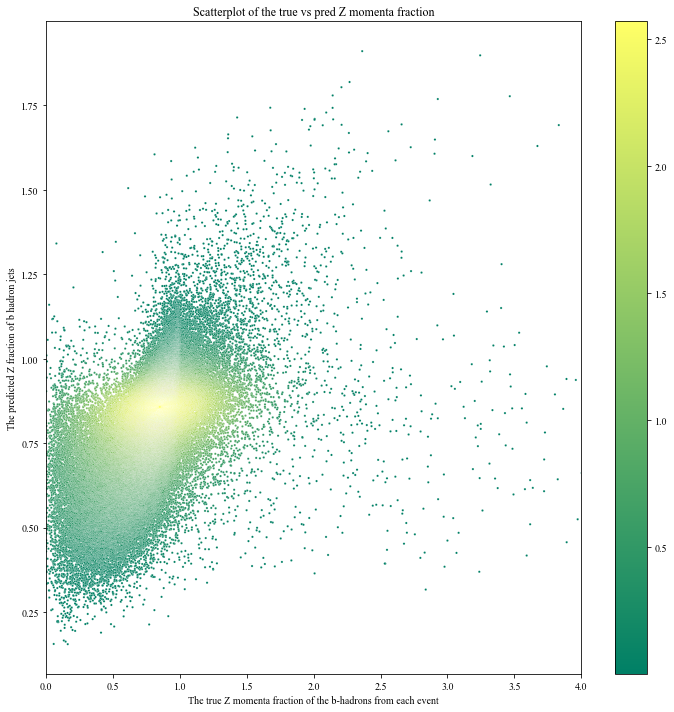

In [71]:
import matplotlib as mpl
from scipy.stats import gaussian_kde
fig, ax = plt.subplots(figsize = (12,12))
x = bhads_targets_clean[:,8]
y = Predictions_X[:,8]
grid = np.vstack([x, y])
z = gaussian_kde(grid)(grid)
idx = z.argsort()
x,y,z = x[idx], y[idx], z[idx]

im = sns.scatterplot(
    x,
    y,
    c = z,
    s = 5,
    cmap = "summer",
    )
norm = plt.Normalize(z.min(), z.max())
sm = plt.cm.ScalarMappable(cmap = "summer", norm = norm)
sm.set_array([])
im.figure.colorbar(sm)
ax.set_xlim([0,4])
ax.set_title("Scatterplot of the true vs pred Z momenta fraction")
ax.set_xlabel("The true Z momenta fraction of the b-hadrons from each event")
ax.set_ylabel("The predicted Z fraction of b hadron jets")

/home/physics/phujdj/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0, 0.5, 'The predicted Bhadron energy of b hadron jets')

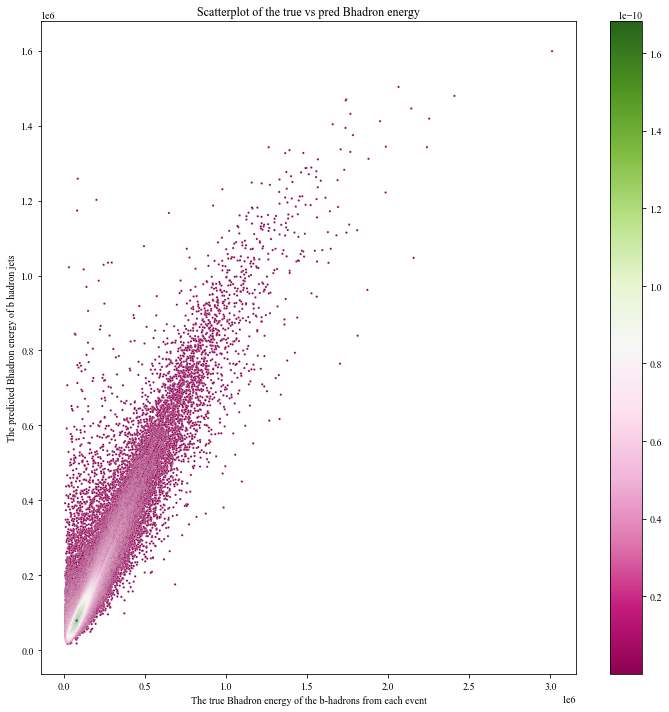

In [72]:
import matplotlib as mpl
from scipy.stats import gaussian_kde
fig, ax = plt.subplots(figsize = (12,12))
x = bhads_targets_clean[:,9]
y = Predictions_X[:,9]
grid = np.vstack([x, y])
z = gaussian_kde(grid)(grid)
idx = z.argsort()
x,y,z = x[idx], y[idx], z[idx]

im = sns.scatterplot(
    x,
    y,
    c = z,
    s = 5,
    cmap = "PiYG",
    )
norm = plt.Normalize(z.min(), z.max())
sm = plt.cm.ScalarMappable(cmap = "PiYG", norm = norm)
sm.set_array([])
im.figure.colorbar(sm)
ax.set_title("Scatterplot of the true vs pred Bhadron energy")
ax.set_xlabel("The true Bhadron energy of the b-hadrons from each event")
ax.set_ylabel("The predicted Bhadron energy of b hadron jets")

/home/physics/phujdj/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0, 0.5, 'The predicted Bhadron projection of b hadron jets')

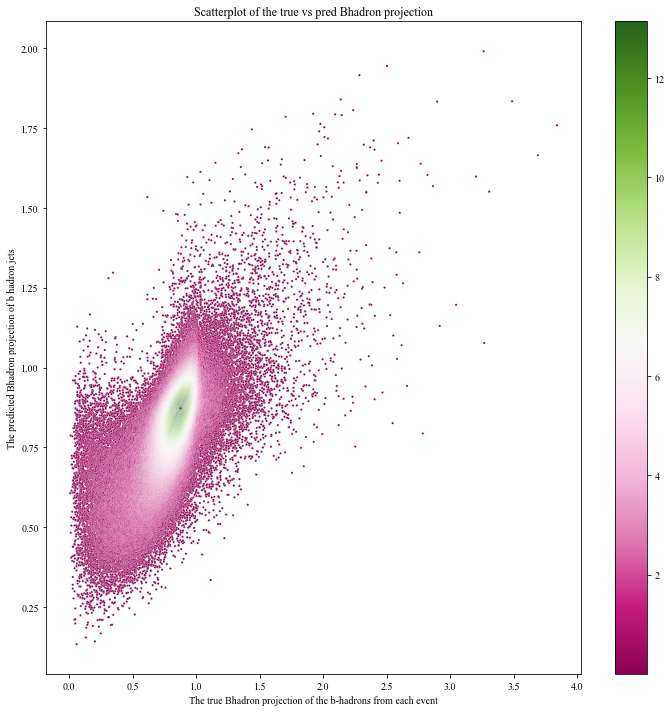

In [73]:
import matplotlib as mpl
from scipy.stats import gaussian_kde
fig, ax = plt.subplots(figsize = (12,12))
x = bhads_targets_clean[:,12]
y = Predictions_X[:,12]
grid = np.vstack([x, y])
z = gaussian_kde(grid)(grid)
idx = z.argsort()
x,y,z = x[idx], y[idx], z[idx]

im = sns.scatterplot(
    x,
    y,
    c = z,
    s = 5,
    cmap = "PiYG",
    )
norm = plt.Normalize(z.min(), z.max())
sm = plt.cm.ScalarMappable(cmap = "PiYG", norm = norm)
sm.set_array([])
im.figure.colorbar(sm)
ax.set_title("Scatterplot of the true vs pred Bhadron projection")
ax.set_xlabel("The true Bhadron projection of the b-hadrons from each event")
ax.set_ylabel("The predicted Bhadron projection of b hadron jets")

In [76]:
from sklearn.metrics import classification_report
print(classification_report(np.argmax(onehot, axis = 1), np.argmax(Predictions_Mass,axis = 1)))

              precision    recall  f1-score   support

           0       0.47      0.52      0.49     41195
           1       0.46      0.58      0.51     41299
           2       0.38      0.00      0.00      9349
           3       0.51      0.01      0.01      4814

    accuracy                           0.47     96657
   macro avg       0.46      0.28      0.26     96657
weighted avg       0.46      0.47      0.43     96657



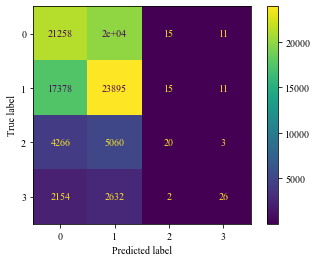

In [77]:
from sklearn.metrics import confusion_matrix
from sklearn import metrics
confusion_mat = confusion_matrix(np.argmax(onehot, axis = 1), np.argmax(Predictions_Mass,axis = 1))
confusion_visualized = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_mat)
confusion_visualized.plot()

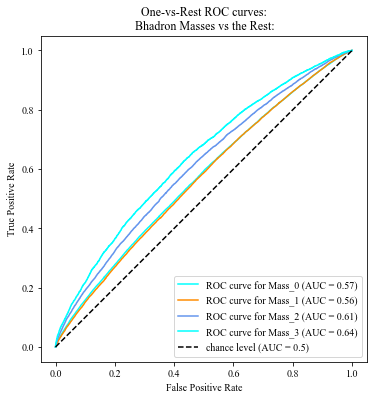

In [78]:
import matplotlib.pyplot as plt
from itertools import cycle
from sklearn.metrics import RocCurveDisplay
target_names = ["Mass_0", "Mass_1", "Mass_2", "Mass_3", "Mass_4", "Mass_5"]
fig, ax = plt.subplots(figsize = (6,6))
colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for class_id, colors in zip(range(4), colors):
    RocCurveDisplay.from_predictions(
        onehot[:,class_id],
        Predictions_Mass[:, class_id],
        name = f"ROC curve for {target_names[class_id]}",
        color = colors,
        ax = ax,
    )
plt.plot([0, 1], [0, 1], "k--", label="chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\n Bhadron Masses vs the Rest:")
plt.legend()
plt.show()

In [62]:
def BhadronPredictor(Track_Data, Jet_Data):
    Predictions = np.stack([DeepSetProjector((Track_Data, Jet_Data))[0] for sample in range(100)])
    Predictions = Predictions.mean(axis = 0)
    lister = []
    index = 0
    predictions_x = Predictions[:,:np.shape(Standardized_Bhads_targets)[1]]
    for bhads_features in range(np.shape(predictions_x)[1]):
        Predictions_temp = predictions_x[:, bhads_features]
        Predictions_temp = (Predictions_temp*stds_original[index]) + means_original[index]
        Predictions_temp = Predictions_temp.reshape(-1,1)
        lister.append(Predictions_temp)
        index+=1
    
    Predictions_Regressed = np.concatenate(lister, axis = 1)
    lister = []
    index = 0
    predictions_x_uncertainty = Predictions[:,np.shape(Standardized_Bhads_targets)[1]:2*np.shape(Standardized_Bhads_targets)[1]]
    for bhads_features in range(np.shape(predictions_x_uncertainty)[1]):
        Predictions_temp = predictions_x_uncertainty[:, bhads_features]
        Predictions_temp = (Predictions_temp*stds_original[index]) + means_original[index]
        Predictions_temp = Predictions_temp.reshape(-1,1)
        lister.append(Predictions_temp)
        index+=1
        Predictions_Uncertainty = np.concatenate(lister, axis = 1)
    
    Predictions_Mass = MassClassifier_Forest.predict(Inputs)

    return Predictions_Regressed, Predictions_Mass

In [63]:
Predictions_Regressed, Predictions_Mass = BhadronPredictor(Tracks_input_scaled, b_jets_input_scaled)

In [73]:
#Convert the predictions of the MassClassifier Forest into a onehot embedding
bhadron_masses_predictions = []
for mass in Predictions_Mass:
    bhadron_masses_predictions.append([str(mass)])
print(np.shape(bhadron_masses_predictions))
encoder = OneHotEncoder(sparse = False)
predictions = encoder.fit_transform(bhadron_masses_predictions)
predictions = np.array(predictions)
print(np.shape(predictions))

(96657, 1)
(96657, 4)


/home/physics/phujdj/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


Text(0, 0.5, 'The predicted X momenta of b hadron jets')

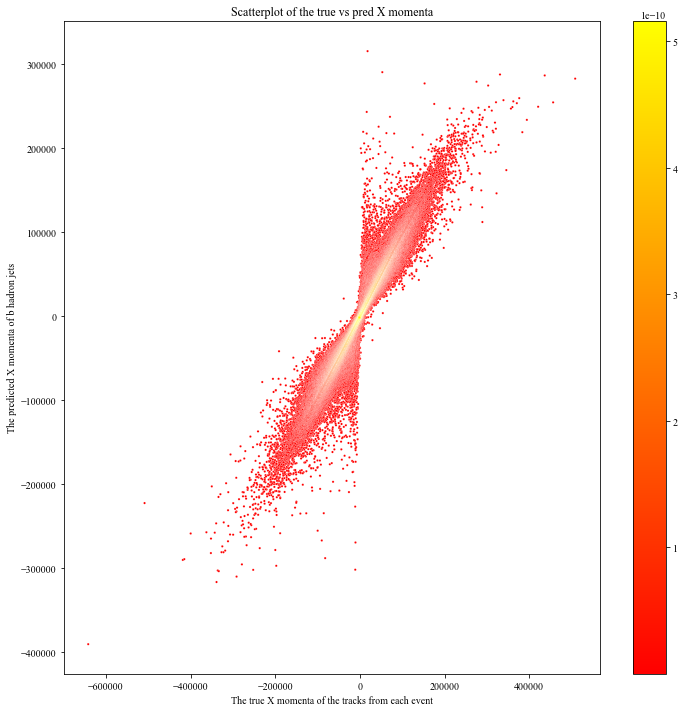

In [64]:
import matplotlib as mpl
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde
fig, ax = plt.subplots(figsize = (12,12))
x = bhads_targets_clean[:,0]
y = Predictions_Regressed[:,0]
grid = np.vstack([x, y])
z = gaussian_kde(grid)(grid)
idx = z.argsort()
x,y,z = x[idx], y[idx], z[idx]

im = sns.scatterplot(
    x,
    y,
    c = z,
    s = 5,
    cmap = "autumn",
    )
norm = plt.Normalize(z.min(), z.max())
sm = plt.cm.ScalarMappable(cmap = "autumn", norm = norm)
sm.set_array([])
im.figure.colorbar(sm)
ax.set_title("Scatterplot of the true vs pred X momenta")
ax.set_xlabel("The true X momenta of the tracks from each event")
ax.set_ylabel("The predicted X momenta of b hadron jets")

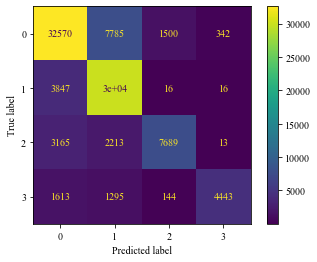

In [85]:
#Compute the confusion matrix for the random forest model's 
#predictions
from sklearn.metrics import confusion_matrix
from sklearn import metrics
confusion_mat = confusion_matrix(Predictions_Mass, Bhad_Mass_Labels)
confusion_visualized = metrics.ConfusionMatrixDisplay(confusion_matrix = confusion_mat)
confusion_visualized.plot()

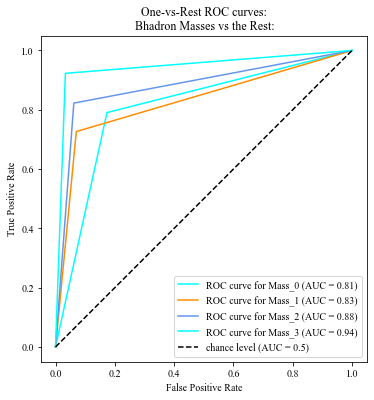

In [86]:
import matplotlib.pyplot as plt
from itertools import cycle
from sklearn.metrics import RocCurveDisplay
target_names = ["Mass_0", "Mass_1", "Mass_2", "Mass_3", "Mass_4", "Mass_5"]
fig, ax = plt.subplots(figsize = (6,6))
colors = cycle(["aqua", "darkorange", "cornflowerblue"])
for class_id, colors in zip(range(4), colors):
    RocCurveDisplay.from_predictions(
        onehot[:,class_id],
        predictions[:, class_id],
        name = f"ROC curve for {target_names[class_id]}",
        color = colors,
        ax = ax,
    )
plt.plot([0, 1], [0, 1], "k--", label="chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("One-vs-Rest ROC curves:\n Bhadron Masses vs the Rest:")
plt.legend()
plt.show()